# <center> IBM Data Science Professional Certificate Capstone Project </center>

This notebook will be used for my Capstone Project of IBM Data Science Professional Certificate course powered by Coursera

## <center>The Battle of Neighborhoods</center>

In [81]:
#importing needed libraries

import pandas as pd
import numpy as np

import types

import folium
from folium.features import DivIcon, FeatureGroup
from folium import plugins
from folium.map import *

import requests

from bs4 import BeautifulSoup

from geopy.geocoders import Nominatim

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.image as mpimg

from mpl_toolkits.mplot3d import Axes3D

import re

import json

import time

import statistics as st

from sklearn.cluster import KMeans, DBSCAN 
from sklearn import metrics
from sklearn import preprocessing
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
#from sklearn.externals.six import StringIO
from sklearn import tree

from scipy.spatial.distance import cdist

from shapely.geometry import Point, Polygon

import pydotplus

from graphviz import Digraph

from io import StringIO

In [82]:
#setting option

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

%matplotlib inline 

In [4]:
print("Hello Capstone Project Course!")

Hello Capstone Project Course!


### 4th week Final Assignment

# <center> Toward a better city </center>

## 1. Introduction - Business problem

### Question  
  
  #### Which can be considered good investments  in order to improve the quality level of the tough Neighborhoods of the city?

### Context 
  
  **The public administration of the City of Chicago** (**the customer/stakeholder**) is going to build its plan for future development of the city.  
  The view of administrators is the rebalancing of different areas of the city in terms of life quality and perception.  
  A better Neighborhood doesn't mean a positive improve only of their habitants, but for all the city: young people, growing in a favorable environment, could be stimuled to gain a higher education and have a perspective for higher salaries and life quality/style, a redeveloped Neighborhood can attract more people and businesses, properties can rise their values, etc...and all these improvements can bring to higher taxes paid in return to the city, safer Neighborhood where the need of public intervent is reduced, etc.. (returns on investment).  
    
For this reason the Pubblic Administration is willing to better understand how to use their budget and a Data Scientists team has been asked to analyze and suggest potential investements.
  

### Identified business requirements
  
The Data Scientists team has identified the following requirements:  
  
* Evaluating if venues or activities help in the redevelopment process of a tough Neighborhood or not
* Evaluating which venue or activity categories should be stimulated by the mean of public investments
* Deploying a priority chart for venue categories that improve a Neighborhood
* Evaluating if maybe some venue category can have the opposite effect, i.e. they promote degradation of the Neighborhood 

## 2. Data Overview

In order to perform the analysis, Data Scientists team will use:  
1. **Chicago socioeconomic dataset**  

   This dataset is available from the website of the City of Chicago (https://data.cityofchicago.org/Health-Human-Services/Selected-socioeconomic-indicators-by-neighborhood/i9hv-en6g) and contains a selection of six socioeconomic indicators of public health significance and a **“hardship index”** by Chicago community area. The indicators are:  
    - the percent of occupied housing units with more than one person per room (i.e., crowded housing);  
    - the percent of households living below the federal poverty level;  
    - the percent of persons in the labor force over the age of 16 years that are unemployed;  
    - the percent of persons over the age of 25 years without a high school diploma; the percent of the population under 18 or over 64 years of age (i.e., dependency);  
    - and per capita income;  
    - hardship index.  

   Indicators for Chicago as a whole are provided in the final row of the table.  
   

2. **Chicago reported crimes dataset**  

    This dataset (available at https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-present/ijzp-q8t2) reflects reported incidents of crime (with the exception of murders where data exists for each victim) that occurred in the City of Chicago from 2001 to present and contains the following fields:
    - ID: unique identifier for the record;
    - Case Number: the Chicago Police Department RD Number (Records Division Number), which is unique to the incident;
    - Date: date when the incident occurred. this is sometimes a best estimate;
    - Block: the partially redacted address where the incident occurred, placing it on the same block as the actual address;
    - IUCR: the Illinois Unifrom Crime Reporting code. This is directly linked to the Primary Type and Description;
    - Description: the secondary description of the IUCR code, a subcategory of the primary description;
    - Location Description: description of the location where the incident occurred;
    - Arrest: indicates whether an arrest was made;
    - Domestic: indicates whether the incident was domestic-related as defined by the Illinois Domestic Violence Act;
    - Beat: indicates the beat where the incident occurred. A beat is the smallest police geographic area – each beat has a dedicated police beat car. Three to five beats make up a police sector, and three sectors make up a police district. The Chicago Police Department has 22 police districts. See the beats at https://data.cityofchicago.org/d/aerh-rz74;
    - District: indicates the police district where the incident occurred. See the districts at https://data.cityofchicago.org/d/fthy-xz3r;
    - Ward: the ward (City Council district) where the incident occurred. See the wards at https://data.cityofchicago.org/d/sp34-6z76;
    - Community Area: indicates the community area where the incident occurred. Chicago has 77 community areas. See the community areas at https://data.cityofchicago.org/d/cauq-8yn6;
    - FBI Code: indicates the crime classification as outlined in the FBI's National Incident-Based Reporting System (NIBRS). See the Chicago Police Department listing of these classifications at http://gis.chicagopolice.org/clearmap_crime_sums/crime_types.html;
    - X Coordinate: the x coordinate of the location where the incident occurred in State Plane Illinois East NAD 1983 projection. This location is shifted from the actual location for partial redaction but falls on the same block;
    - Y Coordinate: the y coordinate of the location where the incident occurred in State Plane Illinois East NAD 1983 projection. This location is shifted from the actual location for partial redaction but falls on the same block;
    - Year: year the incident occurred;
    - Updated On: date and time the record was last updated;
    - Latitude: the latitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block;
    - Longitude: the longitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block;
    - Location: the location where the incident occurred in a format that allows for creation of maps and other geographic operations on this data portal. This location is shifted from the actual location for partial redaction but falls on the same block.  
      
    These two databases will be mainly used to cluster and label Chicago Neighborhoods considering their:  
      - hardship index;
      - crime frequency;
      - degree of crime  
      
      
3. **Chicago Community Area Boundaries geoJson file**  
  
    This file is also available on the Chicago city website and will be used in order to:
      - visualize data for different Community Areas on map;
      - collect venues for all the city and assigning them to the relative Community Area  


4. **Foursquare venues and checkins API**  

    The Team will use Foursquare API in order to discover venues in a specific Neighborhood or at a specific location. In addition checkins will be eventually used to analyze the popularity of specific venues.  
      
5. **Chicago Community Area population and area data**  

    Data about population and surface area of each Community Area, available on Wikipedia at this address https://en.wikipedia.org/wiki/Community_areas_in_Chicago. These data will be used for feature engineering purpose, when they will form ratios of venues per citizen per surface area unit of each Community Area.

Let's give an overview of dataset structures

In [38]:
#importing SocioEconomic dataframe

dfSE = pd.read_csv("Census.csv")

print(dfSE.shape)
dfSE.head()

(78, 9)


,Community Area Number,COMMUNITY AREA NAME,PERCENT OF HOUSING CROWDED,PERCENT HOUSEHOLDS BELOW POVERTY,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,PER CAPITA INCOME,HARDSHIP INDEX
0,1.0,Rogers Park,7.7,23.6,8.7,18.2,27.5,23939,39.0
1,2.0,West Ridge,7.8,17.2,8.8,20.8,38.5,23040,46.0
2,3.0,Uptown,3.8,24.0,8.9,11.8,22.2,35787,20.0
3,4.0,Lincoln Square,3.4,10.9,8.2,13.4,25.5,37524,17.0
4,5.0,North Center,0.3,7.5,5.2,4.5,26.2,57123,6.0


In [25]:
print("Range of Hardship index is: ", dfSE['HARDSHIP INDEX'].min()," - ", dfSE['HARDSHIP INDEX'].max())

Range of Hardship index is:  1.0  -  98.0


In [58]:
#importing Crimes dataframe

dfCrimes = pd.read_csv("Crimes.csv")

print(dfCrimes.shape)
dfCrimes.head()

c:\users\user\appdata\local\programs\python\python38\lib\site-packages\IPython\core\interactiveshell.py:3062: DtypeWarning: Columns (21) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


(7130308, 22)


,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,11034701,JA366925,01/01/2001 11:00:00 AM,016XX E 86TH PL,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,RESIDENCE,False,False,412,4.0,8.0,45.0,11,NaN,NaN,2001,08/05/2017 03:50:08 PM,NaN,NaN,NaN
1,11227287,JB147188,10/08/2017 03:00:00 AM,092XX S RACINE AVE,0281,CRIM SEXUAL ASSAULT,NON-AGGRAVATED,RESIDENCE,False,False,2222,22.0,21.0,73.0,02,NaN,NaN,2017,02/11/2018 03:57:41 PM,NaN,NaN,NaN
2,11227583,JB147595,03/28/2017 02:00:00 PM,026XX W 79TH ST,0620,BURGLARY,UNLAWFUL ENTRY,OTHER,False,False,835,8.0,18.0,70.0,05,NaN,NaN,2017,02/11/2018 03:57:41 PM,NaN,NaN,NaN
3,11227293,JB147230,09/09/2017 08:17:00 PM,060XX S EBERHART AVE,0810,THEFT,OVER $500,RESIDENCE,False,False,313,3.0,20.0,42.0,06,NaN,NaN,2017,02/11/2018 03:57:41 PM,NaN,NaN,NaN
4,11227634,JB147599,08/26/2017 10:00:00 AM,001XX W RANDOLPH ST,0281,CRIM SEXUAL ASSAULT,NON-AGGRAVATED,HOTEL/MOTEL,False,False,122,1.0,42.0,32.0,02,NaN,NaN,2017,02/11/2018 03:57:41 PM,NaN,NaN,NaN


The geoJson with boundaries informations of Chicago Community Areas has been downloaded at https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Community-Areas-current-/cauq-8yn6 and saved as "chicago.json". Let's see how it is formatted

In [43]:
#analyzing the file structure

with open("chicago.json") as file:
   data = file.read()
print(data[0:450])

{
  "type": "FeatureCollection",
  "features": [
    {"type":"Feature","properties":{"community":"DOUGLAS","area":"0","shape_area":"46004621.1581","perimeter":"0","area_num_1":"35","area_numbe":"35","comarea_id":"0","comarea":"0","shape_len":"31027.0545098"},"geometry":{"type":"MultiPolygon","coordinates":[[[[-87.60914087617894,41.84469250265398],[-87.60914874757808,41.84466159842403],[-87.6091611204126,41.84458961193954],[-87.60916766215838,41.8


Let's finally scrape Chicago population and surface area information from the Wikipedia table

In [171]:
scrapUrl = 'https://en.wikipedia.org/wiki/Community_areas_in_Chicago' # the url of the webpage we want to scrape

response = requests.get(scrapUrl) # we use requests to get the webpage at the set url

soup = BeautifulSoup(response.content, 'html.parser') # we use Beautiful Soup to parse the file got by the requests.get() method 

myTable = soup.find("table") # we save the html code between tag <table> in the myTable variable

tableRows = myTable.find_all("tr") # we save all the table rows code in the tableRows variable

In [172]:
rowsList = [] # list of lists of table rows values

for tr in tableRows:
    td = tr.find_all("td")
    row = [i.text[:-1] for i in td]
    if len(row) != 0 and row[0] != 'Total':
        rowsList.append(row)

dfChicagoPopArea = pd.DataFrame(np.array(rowsList), columns=["0", "1", "2","3", "4", "5"])
dfChicagoPopArea.drop(columns = ["1","2","3","4"], axis=1, inplace=True)
dfChicagoPopArea.columns = ['Community Area Number','Community Area Population Density [people/km^2]']
dfChicagoPopArea

,Community Area Number,Community Area Population Density [people/km^2]
0,01,"11,554.11"
1,02,"8,336.20"
2,03,"9,648.06"
3,04,"6,291.50"
4,05,"6,740.59"
5,06,"12,433.23"
6,07,"8,273.10"
7,08,"12,526.20"
8,09,"1,635.30"
9,10,"3,276.92"


In [117]:
dfChicagoPopArea.to_csv('dfChicagoPopArea.csv', index=False)

### end of 4th week Final Assignment

### 5th week Final Assignment

## 3. Methodology

The strategy we want to adopt is that to try to find if some venue category can have an impact on the quality of the City Community Area.  
So first we need to categorize these Areas. In a first way we could have relied only on the "Hardship Index" found in the Chicago SocioEconomic dataset.  
Anyway this approach doesn't seems the best for the following reasons:  
* The hardship index is a continuous value (in the range 1-98) but we want to find few categories in which classify the Community Area (such as: very good, good, average, bad, very bad)  
* The hardship index itself is related only to socio economic conditions of local population and doesn't keep into account also another important aspect of the quality of life in a neighborhood such as its crime rate  

So we take in consideration also the dataset of registered crimes in Chicago and we will "merge" these two informations in order to cluster the Community Areas.  
After clustering we will obtain a new labelled feature, i.e. the category to which each Community Area belongs to.
In the data preparation (exploration and wrangling) section so we will not only clean and manipulate our original dataset, but we will build a clustering model that we will use to build our final dataset to be used for our final goal.  
After collecting the most possible information about venues in Chicago (Foursquare API returns the reccomended venues and not all those in a specified area), and adding information about population and surface area, we will complete teh building of our final dataset that will include:  

* Community Area Name
* Community Area Number
* Community Area Class of Quality
* Number of Venue for each main Venue Category / Community Area Population Ratio (Venue Category from Foursquare will be manipulated in order to have only fewer Category Types. See on the relative cells block)
* Number of Venue for each main Venue Category / Community Area Surface Area

With this dataset we will build our final Tree classification model that should predict the Venue Categories/Population-Area ratios that determine in which category every Community Area falls, giving as a consequence an indication on which kind of venue Public Administration should invest their resources.

### 3.1 Data Exploration and Wrangling

Let's start analyzing a little further our datasets.  
From the Chicago Socioeconomic dataset let's keep only the following columns:  
* Community Area Number;
* Community Area Name;
* Hardhip Index  
  
and let's remove the final row that is referred to the whole city

In [39]:
#slicing datframe

dfSE_fin = dfSE[['Community Area Number', 'COMMUNITY AREA NAME','HARDSHIP INDEX']]
dfSE_fin.head()

,Community Area Number,COMMUNITY AREA NAME,HARDSHIP INDEX
0,1.0,Rogers Park,39.0
1,2.0,West Ridge,46.0
2,3.0,Uptown,20.0
3,4.0,Lincoln Square,17.0
4,5.0,North Center,6.0


In [40]:
#deleting last row that refers to the whole city

dfSE_fin = dfSE_fin.drop([77], axis=0)
dfSE_fin.shape

(77, 3)

Let's visualize the situation of Chicago Areas upon their Hardship Index. In order to do this we use the geoJson file we downloaded. We want to:  
* cast it into a dictionary variable for future usage 
* check if all the listed community area are in uppercase and confront them with those listed in the socioeconomic dataframe. These two series must match because we will use them to visualize Community Area HArdship Index in a choropleth map

In [44]:
#saving the json file into a dict variable for traversing purpose

dataDict = json.loads(data)

In [45]:
#verifying if all community area names are in uppercase and saving them into a list

areaLatList = []
areaLongList = []
tempLat = []
tempLong = []
areaLatList.clear()
areaLongList.clear()
tempList = []
value3 = []
jsonComAreaList = []
for key, value in dataDict.items():
    if type(value) == list:
        for i in range (len(value)):
            #print(value[i])
            for key2, value2 in value[i].items():
                tempLat.clear()
                tempLong.clear()
                if type(value2) == dict and 'community' in value2:
                    jsonComAreaList.append(value2['community'])
print(jsonComAreaList)

['DOUGLAS', 'OAKLAND', 'FULLER PARK', 'GRAND BOULEVARD', 'KENWOOD', 'LINCOLN SQUARE', 'WASHINGTON PARK', 'HYDE PARK', 'WOODLAWN', 'ROGERS PARK', 'JEFFERSON PARK', 'FOREST GLEN', 'NORTH PARK', 'ALBANY PARK', 'PORTAGE PARK', 'IRVING PARK', 'DUNNING', 'MONTCLARE', 'BELMONT CRAGIN', 'WEST RIDGE', 'HERMOSA', 'AVONDALE', 'LOGAN SQUARE', 'HUMBOLDT PARK', 'WEST TOWN', 'AUSTIN', 'WEST GARFIELD PARK', 'EAST GARFIELD PARK', 'NEAR WEST SIDE', 'NORTH LAWNDALE', 'UPTOWN', 'SOUTH LAWNDALE', 'LOWER WEST SIDE', 'NEAR SOUTH SIDE', 'ARMOUR SQUARE', 'NORWOOD PARK', 'NEAR NORTH SIDE', 'LOOP', 'SOUTH SHORE', 'CHATHAM', 'AVALON PARK', 'SOUTH CHICAGO', 'BURNSIDE', 'MCKINLEY PARK', 'LAKE VIEW', 'CALUMET HEIGHTS', 'ROSELAND', 'NORTH CENTER', 'PULLMAN', 'SOUTH DEERING', 'EAST SIDE', 'WEST PULLMAN', 'RIVERDALE', 'HEGEWISCH', 'GARFIELD RIDGE', 'ARCHER HEIGHTS', 'BRIGHTON PARK', 'BRIDGEPORT', 'NEW CITY', 'WEST ELSDON', 'GAGE PARK', 'CLEARING', 'WEST LAWN', 'CHICAGO LAWN', 'WEST ENGLEWOOD', 'ENGLEWOOD', 'GREATER GRA

All community area names in the geoJson file are in uppercase. So let's substitute the values in the dfSE_fin "community Area" dataset column with their corresponding uppercase values

In [46]:
#converting dataframe community area names in uppercase and verifying names match with those of geoJson file

comArea = []

for i,name in enumerate(dfSE_fin['COMMUNITY AREA NAME']):
    comArea.append(name.upper())
    print(i, " ", comArea[i])

0   ROGERS PARK
1   WEST RIDGE
2   UPTOWN
3   LINCOLN SQUARE
4   NORTH CENTER
5   LAKE VIEW
6   LINCOLN PARK
7   NEAR NORTH SIDE
8   EDISON PARK
9   NORWOOD PARK
10   JEFFERSON PARK
11   FOREST GLEN
12   NORTH PARK
13   ALBANY PARK
14   PORTAGE PARK
15   IRVING PARK
16   DUNNING
17   MONTCLAIRE
18   BELMONT CRAGIN
19   HERMOSA
20   AVONDALE
21   LOGAN SQUARE
22   HUMBOLDT PARK
23   WEST TOWN
24   AUSTIN
25   WEST GARFIELD PARK
26   EAST GARFIELD PARK
27   NEAR WEST SIDE
28   NORTH LAWNDALE
29   SOUTH LAWNDALE
30   LOWER WEST SIDE
31   LOOP
32   NEAR SOUTH SIDE
33   ARMOUR SQUARE
34   DOUGLAS
35   OAKLAND
36   FULLER PARK
37   GRAND BOULEVARD
38   KENWOOD
39   WASHINGTON PARK
40   HYDE PARK
41   WOODLAWN
42   SOUTH SHORE
43   CHATHAM
44   AVALON PARK
45   SOUTH CHICAGO
46   BURNSIDE
47   CALUMET HEIGHTS
48   ROSELAND
49   PULLMAN
50   SOUTH DEERING
51   EAST SIDE
52   WEST PULLMAN
53   RIVERDALE
54   HEGEWISCH
55   GARFIELD RIDGE
56   ARCHER HEIGHTS
57   BRIGHTON PARK
58   MCKINLEY PARK

In [47]:
#checking if len of the two lists match

print(len(jsonComAreaList) == len(comArea))

True


In [48]:
#checking if community area names in the two lists match

for name in comArea:
    if not(name in jsonComAreaList):
        print(name)

MONTCLAIRE
WASHINGTON HEIGHT
O'HARE


In [49]:
#checking which names are in the geoJson file

print(set(jsonComAreaList)-set(comArea))

{'OHARE', 'WASHINGTON HEIGHTS', 'MONTCLARE'}


In [50]:
#we have 3 not matching names in the two list. Let's fix them

comArea[17] = "MONTCLARE"
comArea[72] = "WASHINGTON HEIGHTS"
comArea[75] = "OHARE"

In [51]:
#uppercasing community area names in the dataframe

dfSE_fin['COMMUNITY AREA NAME'] = comArea
dfSE_fin.head()

,Community Area Number,COMMUNITY AREA NAME,HARDSHIP INDEX
0,1.0,ROGERS PARK,39.0
1,2.0,WEST RIDGE,46.0
2,3.0,UPTOWN,20.0
3,4.0,LINCOLN SQUARE,17.0
4,5.0,NORTH CENTER,6.0


Let's find now the geo coordinates of Chicago

In [278]:
address = 'Chicago, IL'
geolocator = Nominatim(user_agent="chicago_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Chicago are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Chicago are 41.8755616, -87.6244212.


Let's build a choropleth map showing Chicago Community Areas and their hardship index

In [53]:
#lat and long fetched through geocoder sometimes overlap boundaries in the geoJson file, so I calculate centroid of community area polygon

areaLatList = []
areaLongList = []
tempLat = []
tempLong = []
areaLatList.clear()
areaLongList.clear()
tempList = []
value3 = []
for key, value in dataDict.items():
    if type(value) == list:
        for i in range (len(value)):
            for key2, value2 in value[i].items():
                tempLat.clear()
                tempLong.clear()
                if type(value2) == dict and 'coordinates' in value2:
                    value3.clear()
                    value3 = value2['coordinates'][0][0]
                    for j, coords in enumerate(value3): 
                        tempLat.append(coords[1])
                        tempLong.append(coords[0])
                        if j == (len(value3)-1):
                            areaLatList.append(st.mean(tempLat))
                            areaLongList.append(st.mean(tempLong))

In [54]:
#let's reorder this two lists in order to have values corresponding to the correct community area

dumpLat = []
dumpLong = []
for name in comArea:
    for j, nameJ in enumerate(jsonComAreaList):
        if nameJ == name:
            dumpLat.append(areaLatList[j])
            dumpLong.append(areaLongList[j])

print(len(dumpLat)," ", len(dumpLong))

77   77


In [55]:
#this is not really necessary

dfSE_fin['LATITUDE'] = dumpLat
dfSE_fin['LONGITUDE'] = dumpLong
dfSE_fin.head()

,Community Area Number,COMMUNITY AREA NAME,HARDSHIP INDEX,LATITUDE,LONGITUDE
0,1.0,ROGERS PARK,39.0,42.011938,-87.665677
1,2.0,WEST RIDGE,46.0,41.999314,-87.697159
2,3.0,UPTOWN,20.0,41.965619,-87.644680
3,4.0,LINCOLN SQUARE,17.0,41.974304,-87.694233
4,5.0,NORTH CENTER,6.0,41.946454,-87.687485


In [56]:
#this list is created to label the markers on the map
comAreaTitle = []
for name in comArea:
    comAreaTitle.append(name.title())

In [62]:
json_data = f"chicago.json"

map_chicago = folium.Map(location=[latitude, longitude], zoom_start=11)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Community Area Hardship Index',
    data=dfSE_fin,
    columns=['COMMUNITY AREA NAME', 'HARDSHIP INDEX'],
    key_on='feature.properties.community',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.5,
    legend_name='Chicago Community Area Hardship Index'
).add_to(map_chicago)

    
areaNames = FeatureGroup(name = 'Community Area Name Markers')


for area, lat, lng, hardship in zip(comAreaTitle,dumpLat,dumpLong,list(dfSE_fin['HARDSHIP INDEX'])):
    Marker(location = [lat, lng], popup = area, tooltip = None, draggable = False).add_to(areaNames)

    
areaNames.add_to(map_chicago)


LayerControl().add_to(map_chicago)

map_chicago

Above we can see the distribution of Community Area in Chicago coloured upon their Hardship Index. We notice that the worst areas are mainly placed in a peripherical zone parallel to the coast. North-East areas are those with a better (lower) Hardship Index. Clicking on the Marker points, the name of the Community Area is displayed. Markers can be switched off by unticking their layer on the map layer control at top right corner of the map.

Let's explore now our second dataset. As it was initially quite big (over 7 millions of rows and more than 1GB as file dimension), after first cleaning, I have saved the final dataframe(s) as csv, so that in next runs of the notebook I directly load the saved dataframe(s) and I have not to repeat the whole time and resources costing process.

First, let's remove columns we don't need.  
The idea is to see if areas with a harder Hardship Index have some correlation with ares in which there have been more crimes, than use both dataframes to cluster Chicago areas on the basis of their life quality.  
So, in the crimes dataset we keep the date in order to analyze the trend of crimes in Chicago, the Community Area where crimes were committed and Arrest field in order to try to give each crime a "weight" on the basis of its gravity.

In [59]:
#listing columns names in order to quickly copy and past just the interesting ones
dfCrimes.columns

Index(['ID', 'Case Number', 'Date', 'Block', 'IUCR', 'Primary Type',
       'Description', 'Location Description', 'Arrest', 'Domestic', 'Beat',
       'District', 'Ward', 'Community Area', 'FBI Code', 'X Coordinate',
       'Y Coordinate', 'Year', 'Updated On', 'Latitude', 'Longitude',
       'Location'],
      dtype='object')

In [60]:
#reducing dataframe with the interesting features
dfCrimes_fin = dfCrimes[['Date', 'Arrest', 'Community Area']]
dfCrimes_fin.head()

,Date,Arrest,Community Area
0,01/01/2001 11:00:00 AM,False,45.0
1,10/08/2017 03:00:00 AM,False,73.0
2,03/28/2017 02:00:00 PM,False,70.0
3,09/09/2017 08:17:00 PM,False,42.0
4,08/26/2017 10:00:00 AM,False,32.0


Let's check which data types a re stored in our new dataframe

In [26]:
#checking dataframe value types
dfCrimes_fin.dtypes

Date               object
Arrest               bool
Community Area    float64
dtype: object

Let's cast 'Date' feature from object to datetime in order to quickly grab only the year information from it

In [61]:
#casting date object values into datetime values
dfCrimes_fin.loc[:,'Date']= pd.to_datetime(dfCrimes_fin['Date'])

c:\users\user\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


In [62]:
dfCrimes_fin.dtypes

Date              datetime64[ns]
Arrest                      bool
Community Area           float64
dtype: object

From the Date column let's extract the year and save it in a new column

In [63]:
dfCrimes_fin['Year'] = dfCrimes_fin['Date'].dt.year
dfCrimes_fin.head()

<ipython-input-63-652fc4e67e18>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCrimes_fin['Year'] = dfCrimes_fin['Date'].dt.year


,Date,Arrest,Community Area,Year
0,2001-01-01 11:00:00,False,45.0,2001
1,2017-10-08 03:00:00,False,73.0,2017
2,2017-03-28 14:00:00,False,70.0,2017
3,2017-09-09 20:17:00,False,42.0,2017
4,2017-08-26 10:00:00,False,32.0,2017


In [30]:
dfCrimes_fin.shape

(7130308, 4)

We don't need the Date fied anymore. Let's drop it

In [64]:
dfCrimes_fin = dfCrimes_fin.drop("Date", axis=1)
dfCrimes_fin.head()

,Arrest,Community Area,Year
0,False,45.0,2001
1,False,73.0,2017
2,False,70.0,2017
3,False,42.0,2017
4,False,32.0,2017


Let's re arrange columns order

In [65]:
dfCrimes_fin = dfCrimes_fin[['Community Area','Year','Arrest']]
dfCrimes_fin.head()

,Community Area,Year,Arrest
0,45.0,2001,False
1,73.0,2017,False
2,70.0,2017,False
3,42.0,2017,False
4,32.0,2017,False


Year column is a float. Let's cast it into a int and summarize the main informations and statistics about our dataframe

In [33]:
dfCrimes_fin['Year'] = dfCrimes_fin['Year'].astype(int)
dfCrimes_fin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7130308 entries, 0 to 7130307
Data columns (total 3 columns):
 #   Column          Dtype  
---  ------          -----  
 0   Community Area  float64
 1   Year            int32  
 2   Arrest          bool   
dtypes: bool(1), float64(1), int32(1)
memory usage: 88.4 MB


In [34]:
dfCrimes_fin.describe()

,Community Area,Year
count,6.516823e+06,7.130308e+06
mean,3.755010e+01,2.008898e+03
std,2.153520e+01,5.444896e+00
min,0.000000e+00,2.001000e+03
25%,2.300000e+01,2.004000e+03
50%,3.200000e+01,2.008000e+03
75%,5.700000e+01,2.013000e+03
max,7.700000e+01,2.020000e+03


It looks like there are some rows without any specified Community Area. These are unuseful for our scope, so let's drop them 

In [66]:
dfCrimes_fin.dropna(axis=0, inplace=True)
dfCrimes_fin.describe()

,Community Area,Year
count,6.516823e+06,6.516823e+06
mean,3.755010e+01,2.009619e+03
std,2.153520e+01,5.133920e+00
min,0.000000e+00,2.001000e+03
25%,2.300000e+01,2.005000e+03
50%,3.200000e+01,2.009000e+03
75%,5.700000e+01,2.014000e+03
max,7.700000e+01,2.020000e+03


In [67]:
dfCrimes_fin = pd.get_dummies(data=dfCrimes_fin, prefix="Arrest = ", columns=['Arrest'])
dfCrimes_fin.head()

,Community Area,Year,Arrest = _False,Arrest = _True
0,45.0,2001,1,0
1,73.0,2017,1,0
2,70.0,2017,1,0
3,42.0,2017,1,0
4,32.0,2017,1,0


Let's see how many crimes have been committed in each Community Area

In [37]:
dfCrimes_fin.groupby(['Community Area']).count().sort_values(by=['Arrest = _True'], ascending=False)

,Year,Arrest = _False,Arrest = _True
Community Area,,,
25.0,412769,412769,412769
8.0,226342,226342,226342
43.0,213236,213236,213236
23.0,205715,205715,205715
28.0,193662,193662,193662
24.0,191743,191743,191743
67.0,190431,190431,190431
29.0,189826,189826,189826
71.0,184865,184865,184865


It looks like there are some crimes registered in a Community Area 0.0. These maybe refer to the whole city, as Community Area in Chicago are 77. Let's check it

In [38]:
dfCrimes_fin['Community Area'].unique()

array([45., 73., 70., 42., 32., 69., 65., 30., 22., 44., 13., 52.,  1.,
       46.,  6., 57., 25.,  4., 68., 23., 63., 77.,  8.,  5., 71., 38.,
       61., 53., 19., 29., 56., 43., 27., 26., 76.,  2., 49., 33.,  7.,
       28., 14., 10.,  3., 24., 72., 66., 58., 35., 21., 39., 75., 11.,
       40., 59., 17., 31., 20., 41., 15., 48., 62., 67., 55., 37., 64.,
       50., 16., 34., 60., 54., 51., 36., 12., 47.,  9., 18., 74.,  0.])

Yes, we have a Community Area that is not in Chicago. Crimes registered with this code (0.0) are only 76, so let's drop it

In [68]:
dfCrimes_fin = dfCrimes_fin[dfCrimes_fin['Community Area'] != 0.0]
dfCrimes_fin.shape

(6516747, 4)

In [69]:
listCA = dfCrimes_fin['Community Area'].unique()
listCA

array([45., 73., 70., 42., 32., 69., 65., 30., 22., 44., 13., 52.,  1.,
       46.,  6., 57., 25.,  4., 68., 23., 63., 77.,  8.,  5., 71., 38.,
       61., 53., 19., 29., 56., 43., 27., 26., 76.,  2., 49., 33.,  7.,
       28., 14., 10.,  3., 24., 72., 66., 58., 35., 21., 39., 75., 11.,
       40., 59., 17., 31., 20., 41., 15., 48., 62., 67., 55., 37., 64.,
       50., 16., 34., 60., 54., 51., 36., 12., 47.,  9., 18., 74.])

Ok, now we have the correct number of Community Areas.  
Let's now order all crimes upon the year they were committed.

In [70]:
dfCrimesYears = dfCrimes_fin.groupby(['Year']).count().sort_values(by=['Arrest = _True'], ascending=False)
dfCrimesYears

,Community Area,Arrest = _False,Arrest = _True
Year,,,
2003,475901,475901,475901
2004,469312,469312,469312
2005,453672,453672,453672
2006,448072,448072,448072
2007,436872,436872,436872
2008,426835,426835,426835
2009,392534,392534,392534
2010,370195,370195,370195
2002,354118,354118,354118


It seems there is something of evident. Let's visualize this clearly

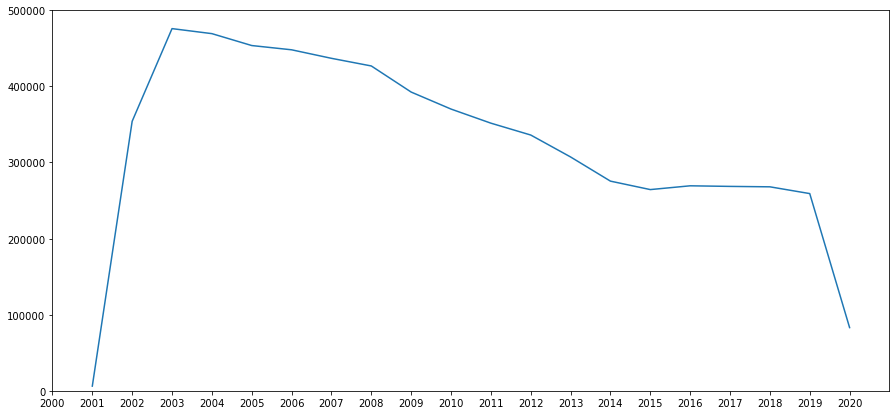

In [71]:
dfCrimestoYears = dfCrimesYears[['Community Area']]
dfCrimestoYears.columns = ['Crimes number']
dfCrimestoYears = dfCrimestoYears.sort_index()
plt.figure(figsize=(15,7))
plt.axis([2000, 2021, 0, 500000])
plt.xticks(np.arange(2000, 2021, 1))
plt.plot(list(dfCrimestoYears.index), dfCrimestoYears['Crimes number'])
plt.show()

We can clearly notice that the trend of crimes in Chicago is negative starting from 2003. We also notice that we have very few crimes number in 2001 and 2020: we can think this is due to the fact that, as data collecting started in 2001, not all crimes during 2001 were registered and obviously, as at the time of redacting this notebook  it is June 2020, also not all crimes of the current year can be present. We notice also that 2002 crimes number is "out of the trend". For the same reasons of 2001 we could think that not all tha crimes were registered. Maybe the collecting system could be not completely tuned at that time; anyway, whichever the reason, as it is referred to 18 years ago we will discard it, as well as those of 2001 and 2020. 

In [72]:
dfCrimes_fin = dfCrimes_fin[dfCrimes_fin['Year'] != 2001]
dfCrimes_fin = dfCrimes_fin[dfCrimes_fin['Year'] != 2002]
dfCrimes_fin = dfCrimes_fin[dfCrimes_fin['Year'] != 2020]
dfCrimes_fin.groupby(['Year']).count().sort_values(by=['Community Area'], ascending=False)

,Community Area,Arrest = _False,Arrest = _True
Year,,,
2003,475901,475901,475901
2004,469312,469312,469312
2005,453672,453672,453672
2006,448072,448072,448072
2007,436872,436872,436872
2008,426835,426835,426835
2009,392534,392534,392534
2010,370195,370195,370195
2011,351675,351675,351675


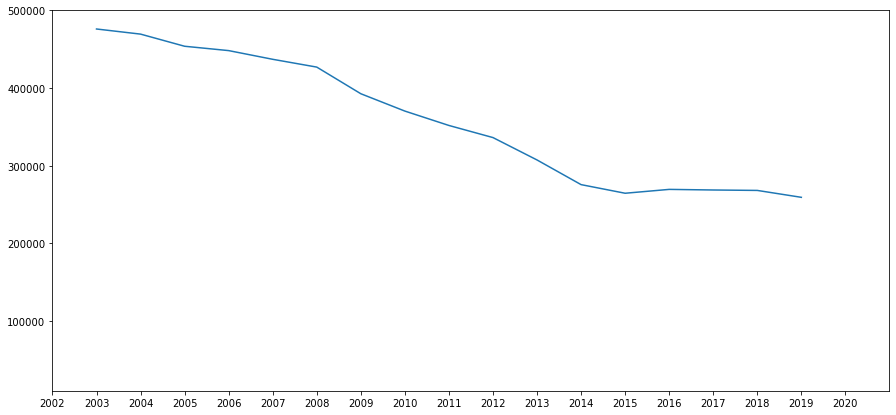

In [73]:
dfCrimestoYears = dfCrimes_fin.groupby(['Year']).count().sort_values(by=['Community Area'], ascending=False)[['Community Area']]
dfCrimestoYears.columns = ['Crimes number']
dfCrimestoYears = dfCrimestoYears.sort_index()
plt.figure(figsize=(15,7))
plt.axis([2002, 2021, 10000, 500000])
plt.xticks(np.arange(2002, 2021, 1))
plt.plot(list(dfCrimestoYears.index), dfCrimestoYears['Crimes number'])
plt.show()

With the exception of 2015 (that anyway is very close to 2014, 2016, 2017 and 2018) the crime trend is definetly negative.  
Before proceeding, let's visualize our dataframe, check its shape and save it for future usage

In [75]:
dfCrimes_fin = dfCrimes_fin.sort_values(by=['Community Area','Year'])
dfCrimes_fin = dfCrimes_fin.reset_index(drop=True)
dfCrimes_fin.head()

,Community Area,Year,Arrest = _False,Arrest = _True
0,1.0,2003,1,0
1,1.0,2003,0,1
2,1.0,2003,1,0
3,1.0,2003,0,1
4,1.0,2003,1,0


In [76]:
dfCrimes_fin.shape

(6073404, 4)

In [85]:
dfCrimes_fin.to_csv("dfCrimes.csv", index=True)
print("File saved!")

File saved!


So, now we have clean our dataframe, but, as we want to use it in order to cluster Chicago Community Area, we move on and transform it in a new dataframe where we will storage, for every Community Area, the number of Arrested and Not Arrested and Total types crimes for every year from 2003 to 2019, more Total Arrested, Total Not Arrested and Grand Total crimes types of the whole time period.
In this way we also transform our initial big sized dataframe into a smaller and more manageable one.

In [22]:
# creating the recursive part list to build list of columns names for our target dataframe
yearsList = []
for i in range(2003,2020):
    yearsList.append(str(i)+ ' Ar')
    yearsList.append(str(i)+ ' No_Ar')
    yearsList.append(str(i)+ ' Total')

In [23]:
# columns names list of our target dataframe
newColumns = ['Community Area'] + yearsList + ['2003-2019 Ar','2003-2019 No_Ar','2003-2019 Total']

Let's load our previously saved dataframe removing the first unwanted column:

In [77]:

dfCrimes_fin = pd.read_csv("dfCrimes.csv")
dfCrimes_fin = dfCrimes_fin.drop("Unnamed: 0", axis=1)
dfCrimes_fin.head()


,Community Area,Year,Arrest = _False,Arrest = _True
0,1.0,2003,1,0
1,1.0,2003,0,1
2,1.0,2003,1,0
3,1.0,2003,0,1
4,1.0,2003,1,0


Now, let's create a dataframe ordered by Community Area, Year and Arrested Case, from which we can read the informations about the number of crimes in the format we decided above.  
We will store these informations in a numpy bidimensional array and then we'll use this array as data source of our target dataframe.

In [78]:
dfCrimesCount = dfCrimes_fin.groupby(["Community Area","Year","Arrest = _True"]).count()
dfCrimesCount.head()

Arrest = _False
Community Area Year Arrest = _True                 
1.0            2003 0                          5344
                    1                          2341
               2004 0                          5375
                    1                          2235
               2005 0                          4975

In [30]:
#checking if we have all information we need
print((len(listCA)*len(list(range(2003,2020)))*2) == dfCrimesCount.shape[0])

True


Let's traverse our last dataframe in order to create the numpy array

In [90]:
# ignoring all warnings messages
import warnings
warnings.filterwarnings('ignore')

crimeLists = np.empty([77, 55])

rDf = 0
cDf = 0
for r in range(0,dfCrimesCount.shape[0]):
    if r%2 == 0 and r < 34:
        cDf = int(2+3*(r/2))
        inputValue = dfCrimesCount.iloc[r][0]
        crimeLists[rDf,cDf] = inputValue
    elif r%2 == 0 and r > 33:
        rDf = int(r/34)
        cDf = int(2+3*((r-(34*rDf))/2))
        inputValue = dfCrimesCount.iloc[r][0]
        crimeLists[rDf,cDf] = inputValue
    elif r%2 == 1 and r < 34:
        cDf = int(1+3*((r-1)/2))
        inputValue = dfCrimesCount.iloc[r][0]
        crimeLists[rDf,cDf] = inputValue
    elif r%2 == 1 and r > 33:
        rDf = int(r/34)
        cDf = int(1+3*(((r-1)-(34*rDf))/2))
        inputValue = dfCrimesCount.iloc[r][0]
        crimeLists[rDf,cDf] = inputValue

And finally let's build our target dataframe

In [91]:
dfCrimesArea = pd.DataFrame(data=crimeLists, index=np.arange(len(listCA)),columns=newColumns)
dfCrimesArea.head()

,Community Area,2003 Ar,2003 No_Ar,2003 Total,2004 Ar,2004 No_Ar,2004 Total,2005 Ar,2005 No_Ar,2005 Total,2006 Ar,2006 No_Ar,2006 Total,2007 Ar,2007 No_Ar,2007 Total,2008 Ar,2008 No_Ar,2008 Total,2009 Ar,2009 No_Ar,2009 Total,2010 Ar,2010 No_Ar,2010 Total,2011 Ar,2011 No_Ar,2011 Total,2012 Ar,2012 No_Ar,2012 Total,2013 Ar,2013 No_Ar,2013 Total,2014 Ar,2014 No_Ar,2014 Total,2015 Ar,2015 No_Ar,2015 Total,2016 Ar,2016 No_Ar,2016 Total,2017 Ar,2017 No_Ar,2017 Total,2018 Ar,2018 No_Ar,2018 Total,2019 Ar,2019 No_Ar,2019 Total,2003-2019 Ar,2003-2019 No_Ar,2003-2019 Total
0,1.147231e-311,2341.0,5344.0,7.317112e-321,2235.0,5375.0,7.331934e-321,2556.0,4975.0,7.346756e-321,2548.0,4659.0,7.361578e-321,2305.0,4503.0,7.376400e-321,1506.0,4992.0,7.391222e-321,1870.0,4093.0,7.406044e-321,1511.0,4068.0,7.420866e-321,1449.0,3676.0,7.435688e-321,1506.0,3420.0,7.450510e-321,1282.0,3155.0,7.465332e-321,1014.0,2793.0,7.480154e-321,914.0,2678.0,7.494976e-321,664.0,3007.0,7.509798e-321,653.0,3501.0,7.524620e-321,650.0,3182.0,7.539442e-321,662.0,3373.0,7.554264e-321,7.559204e-321,7.564145e-321,7.569086e-321
1,7.574026e-321,844.0,4391.0,7.588848e-321,810.0,4950.0,7.603670e-321,1092.0,4750.0,7.618492e-321,1250.0,4802.0,7.633314e-321,1135.0,4135.0,7.648136e-321,770.0,4702.0,7.662958e-321,1114.0,4116.0,7.677780e-321,880.0,4009.0,7.692602e-321,890.0,3536.0,7.707424e-321,763.0,3270.0,7.722246e-321,734.0,3081.0,7.737068e-321,626.0,2788.0,7.751890e-321,619.0,2494.0,7.766712e-321,453.0,2838.0,7.781534e-321,448.0,3153.0,7.796356e-321,441.0,3095.0,7.811178e-321,416.0,3026.0,7.826000e-321,7.830940e-321,7.835881e-321,7.840822e-321
2,7.845762e-321,3042.0,4481.0,7.860584e-321,2757.0,4688.0,7.875406e-321,2935.0,4608.0,7.890228e-321,2494.0,4313.0,7.905050e-321,2384.0,4011.0,7.919872e-321,1318.0,4683.0,7.934694e-321,1556.0,3634.0,7.949516e-321,1405.0,3670.0,7.964338e-321,1550.0,3228.0,7.979160e-321,1621.0,3357.0,7.993982e-321,1353.0,2939.0,8.008804e-321,1284.0,2536.0,8.023626e-321,981.0,2684.0,8.038448e-321,686.0,2883.0,8.053270e-321,622.0,2946.0,8.068092e-321,612.0,3048.0,8.082914e-321,618.0,2720.0,8.097736e-321,8.102677e-321,8.107617e-321,8.112558e-321
3,8.117499e-321,697.0,2576.0,8.132321e-321,640.0,2718.0,8.147142e-321,769.0,2606.0,8.161964e-321,729.0,2556.0,8.176786e-321,658.0,2187.0,8.191608e-321,334.0,2451.0,8.206430e-321,509.0,2131.0,8.221252e-321,461.0,2099.0,8.236074e-321,510.0,1805.0,8.250896e-321,493.0,1846.0,8.265718e-321,405.0,1813.0,8.280540e-321,370.0,1528.0,8.295362e-321,309.0,1461.0,8.310184e-321,260.0,1730.0,8.325006e-321,298.0,1710.0,8.339828e-321,271.0,1669.0,8.354650e-321,215.0,1578.0,8.369472e-321,8.374413e-321,8.379353e-321,8.384294e-321
4,8.389235e-321,865.0,2412.0,8.404057e-321,787.0,2348.0,8.418879e-321,871.0,2119.0,8.433701e-321,737.0,2085.0,8.448523e-321,615.0,2019.0,8.463345e-321,299.0,2295.0,8.478166e-321,425.0,2007.0,8.492988e-321,292.0,1770.0,8.507810e-321,313.0,1635.0,8.522632e-321,282.0,1639.0,8.537454e-321,253.0,1473.0,8.552276e-321,235.0,1307.0,8.567098e-321,187.0,1208.0,8.581920e-321,170.0,1235.0,8.596742e-321,147.0,1279.0,8.611564e-321,123.0,1209.0,8.626386e-321,121.0,1149.0,8.641208e-321,8.646149e-321,8.651089e-321,8.656030e-321


We still lack to fill Community Area and the other derived values columns. Furtehrmore, as all values are integer numbers, let's cast them into integers so that the dataframe is more readable. Let's do that

In [93]:
listCA.sort()
dfCrimesArea['Community Area'] = listCA

for i in range(1,dfCrimesArea.shape[1]):
    dfCrimesArea.iloc[:,i] = dfCrimesArea.iloc[:,i].astype(int)

for i in range(3,(dfCrimesArea.shape[1]-3),3):
    dfCrimesArea.iloc[:,i] = dfCrimesArea.iloc[:,i-2] + dfCrimesArea.iloc[:,i-1]
    
for i in range(3,(dfCrimesArea.shape[1]-3),3):
    dfCrimesArea.iloc[:,(dfCrimesArea.shape[1]-1)] = dfCrimesArea.iloc[:,(dfCrimesArea.shape[1]-1)] + dfCrimesArea.iloc[:,i]
    
for i in range(1,(dfCrimesArea.shape[1]-5),3):
    dfCrimesArea.iloc[:,(dfCrimesArea.shape[1]-3)] = dfCrimesArea.iloc[:,(dfCrimesArea.shape[1]-3)] + dfCrimesArea.iloc[:,i]

for i in range(2,(dfCrimesArea.shape[1]-4),3):
    dfCrimesArea.iloc[:,(dfCrimesArea.shape[1]-2)] = dfCrimesArea.iloc[:,(dfCrimesArea.shape[1]-2)] + dfCrimesArea.iloc[:,i]

dfCrimesArea.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 77 entries, 0 to 76
Data columns (total 55 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Community Area   77 non-null     float64
 1   2003 Ar          77 non-null     int32  
 2   2003 No_Ar       77 non-null     int32  
 3   2003 Total       77 non-null     int32  
 4   2004 Ar          77 non-null     int32  
 5   2004 No_Ar       77 non-null     int32  
 6   2004 Total       77 non-null     int32  
 7   2005 Ar          77 non-null     int32  
 8   2005 No_Ar       77 non-null     int32  
 9   2005 Total       77 non-null     int32  
 10  2006 Ar          77 non-null     int32  
 11  2006 No_Ar       77 non-null     int32  
 12  2006 Total       77 non-null     int32  
 13  2007 Ar          77 non-null     int32  
 14  2007 No_Ar       77 non-null     int32  
 15  2007 Total       77 non-null     int32  
 16  2008 Ar          77 non-null     int32  
 17  2008 No_Ar       7

Let's check our definitive target dataframe

In [100]:
dfCrimesArea.head()

,Community Area,2003 Ar,2003 No_Ar,2003 Total,2004 Ar,2004 No_Ar,2004 Total,2005 Ar,2005 No_Ar,2005 Total,2006 Ar,2006 No_Ar,2006 Total,2007 Ar,2007 No_Ar,2007 Total,2008 Ar,2008 No_Ar,2008 Total,2009 Ar,2009 No_Ar,2009 Total,2010 Ar,2010 No_Ar,2010 Total,2011 Ar,2011 No_Ar,2011 Total,2012 Ar,2012 No_Ar,2012 Total,2013 Ar,2013 No_Ar,2013 Total,2014 Ar,2014 No_Ar,2014 Total,2015 Ar,2015 No_Ar,2015 Total,2016 Ar,2016 No_Ar,2016 Total,2017 Ar,2017 No_Ar,2017 Total,2018 Ar,2018 No_Ar,2018 Total,2019 Ar,2019 No_Ar,2019 Total,2003-2019 Ar,2003-2019 No_Ar,2003-2019 Total
0,1.0,2341,5344,7685,2235,5375,7610,2556,4975,7531,2548,4659,7207,2305,4503,6808,1506,4992,6498,1870,4093,5963,1511,4068,5579,1449,3676,5125,1506,3420,4926,1282,3155,4437,1014,2793,3807,914,2678,3592,664,3007,3671,653,3501,4154,650,3182,3832,662,3373,4035,25666,66794,92460
1,2.0,844,4391,5235,810,4950,5760,1092,4750,5842,1250,4802,6052,1135,4135,5270,770,4702,5472,1114,4116,5230,880,4009,4889,890,3536,4426,763,3270,4033,734,3081,3815,626,2788,3414,619,2494,3113,453,2838,3291,448,3153,3601,441,3095,3536,416,3026,3442,13285,63136,76421
2,3.0,3042,4481,7523,2757,4688,7445,2935,4608,7543,2494,4313,6807,2384,4011,6395,1318,4683,6001,1556,3634,5190,1405,3670,5075,1550,3228,4778,1621,3357,4978,1353,2939,4292,1284,2536,3820,981,2684,3665,686,2883,3569,622,2946,3568,612,3048,3660,618,2720,3338,27218,60429,87647
3,4.0,697,2576,3273,640,2718,3358,769,2606,3375,729,2556,3285,658,2187,2845,334,2451,2785,509,2131,2640,461,2099,2560,510,1805,2315,493,1846,2339,405,1813,2218,370,1528,1898,309,1461,1770,260,1730,1990,298,1710,2008,271,1669,1940,215,1578,1793,7928,34464,42392
4,5.0,865,2412,3277,787,2348,3135,871,2119,2990,737,2085,2822,615,2019,2634,299,2295,2594,425,2007,2432,292,1770,2062,313,1635,1948,282,1639,1921,253,1473,1726,235,1307,1542,187,1208,1395,170,1235,1405,147,1279,1426,123,1209,1332,121,1149,1270,6722,29189,35911


Let's check its dimension

In [101]:
dfCrimesArea.shape

(77, 55)

Nice, we have simplify it while keeping the relevant informations. Let's save it for future usage.

In [103]:
dfCrimesArea.to_csv("dfCrimesArea.csv", index=True)

Following cell are used to load dataframe when the work was interrupted. So they can be commented or uncommented upon the situation

In [79]:

dfCrimesArea = pd.read_csv("dfCrimesArea.csv")
dfCrimesArea = dfCrimesArea.drop("Unnamed: 0", axis=1)
dfCrimesArea.head()


,Community Area,2003 Ar,2003 No_Ar,2003 Total,2004 Ar,2004 No_Ar,2004 Total,2005 Ar,2005 No_Ar,2005 Total,2006 Ar,2006 No_Ar,2006 Total,2007 Ar,2007 No_Ar,2007 Total,2008 Ar,2008 No_Ar,2008 Total,2009 Ar,2009 No_Ar,2009 Total,2010 Ar,2010 No_Ar,2010 Total,2011 Ar,2011 No_Ar,2011 Total,2012 Ar,2012 No_Ar,2012 Total,2013 Ar,2013 No_Ar,2013 Total,2014 Ar,2014 No_Ar,2014 Total,2015 Ar,2015 No_Ar,2015 Total,2016 Ar,2016 No_Ar,2016 Total,2017 Ar,2017 No_Ar,2017 Total,2018 Ar,2018 No_Ar,2018 Total,2019 Ar,2019 No_Ar,2019 Total,2003-2019 Ar,2003-2019 No_Ar,2003-2019 Total
0,1.0,2341,5344,7685,2235,5375,7610,2556,4975,7531,2548,4659,7207,2305,4503,6808,1506,4992,6498,1870,4093,5963,1511,4068,5579,1449,3676,5125,1506,3420,4926,1282,3155,4437,1014,2793,3807,914,2678,3592,664,3007,3671,653,3501,4154,650,3182,3832,662,3373,4035,25666,66794,92460
1,2.0,844,4391,5235,810,4950,5760,1092,4750,5842,1250,4802,6052,1135,4135,5270,770,4702,5472,1114,4116,5230,880,4009,4889,890,3536,4426,763,3270,4033,734,3081,3815,626,2788,3414,619,2494,3113,453,2838,3291,448,3153,3601,441,3095,3536,416,3026,3442,13285,63136,76421
2,3.0,3042,4481,7523,2757,4688,7445,2935,4608,7543,2494,4313,6807,2384,4011,6395,1318,4683,6001,1556,3634,5190,1405,3670,5075,1550,3228,4778,1621,3357,4978,1353,2939,4292,1284,2536,3820,981,2684,3665,686,2883,3569,622,2946,3568,612,3048,3660,618,2720,3338,27218,60429,87647
3,4.0,697,2576,3273,640,2718,3358,769,2606,3375,729,2556,3285,658,2187,2845,334,2451,2785,509,2131,2640,461,2099,2560,510,1805,2315,493,1846,2339,405,1813,2218,370,1528,1898,309,1461,1770,260,1730,1990,298,1710,2008,271,1669,1940,215,1578,1793,7928,34464,42392
4,5.0,865,2412,3277,787,2348,3135,871,2119,2990,737,2085,2822,615,2019,2634,299,2295,2594,425,2007,2432,292,1770,2062,313,1635,1948,282,1639,1921,253,1473,1726,235,1307,1542,187,1208,1395,170,1235,1405,147,1279,1426,123,1209,1332,121,1149,1270,6722,29189,35911


Let's visualize the trend of crimes during the years in all Community Areas

In [34]:
#let's select the columns with the total number of crimes per year
newCols = []
for i,col in enumerate(list(dfCrimesArea.columns)):
    if ('Total' in col) and (i != (len(list(dfCrimesArea.columns))-1)):
        newCols.append(col)

In [35]:
#let's creat a new dataframe for visualization purpose
dfCrimesAreatoYears = dfCrimesArea[['Community Area']+newCols]
dfCrimesAreatoYears.set_index('Community Area', inplace=True)
dfCrimesAreatoYears = dfCrimesAreatoYears.transpose()


In [36]:
#let's change the index with the years
dfCrimesAreatoYears.index = list(np.arange(2003,2020))
dfCrimesAreatoYears.head()

Community Area,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,15.0,16.0,17.0,18.0,19.0,20.0,21.0,22.0,23.0,24.0,25.0,26.0,27.0,28.0,29.0,30.0,31.0,32.0,33.0,34.0,35.0,36.0,37.0,38.0,39.0,40.0,41.0,42.0,43.0,44.0,45.0,46.0,47.0,48.0,49.0,50.0,51.0,52.0,53.0,54.0,55.0,56.0,57.0,58.0,59.0,60.0,61.0,62.0,63.0,64.0,65.0,66.0,67.0,68.0,69.0,70.0,71.0,72.0,73.0,74.0,75.0,76.0,77.0
2003,7685,5235,7523,3273,3277,8808,7948,15471,427,2087,1869,841,1474,4434,6510,5495,3078,1287,8600,3092,4805,11366,15494,15389,30838,7420,9179,15807,12348,7546,5001,9571,3984,1725,6517,893,1937,8571,2937,5244,3308,8059,14630,9370,2298,8380,681,2463,11688,2010,2876,2557,7291,2346,1066,4467,1632,4888,2084,3242,10822,1797,4273,1948,3535,11204,13919,12546,10905,3815,12300,1721,5085,1129,3575,2218,4787
2004,7610,5760,7445,3358,3135,8653,7308,15760,400,1894,1707,775,1509,3801,5929,5160,2801,1036,8146,2841,4827,10654,14541,14156,29488,7880,9192,14768,13370,7893,4762,9307,4357,1652,6846,904,1521,7655,2739,5239,3248,8119,14375,9465,2393,8883,735,2552,11809,1920,2636,2408,7888,2258,1003,4521,1619,4724,2080,3127,10118,1714,3901,1912,3560,10977,14120,12959,11592,3964,13149,1743,5335,1097,3636,2095,4898
2005,7531,5842,7543,3375,2990,7741,6618,14643,461,1748,1610,873,1600,3921,5855,5164,2653,1006,8367,2641,4358,9436,14801,12868,28378,8428,8317,13213,12739,7519,4230,8953,4701,1704,6843,880,1393,6404,2908,5184,3286,7874,14427,9653,2384,8288,715,2339,11675,1820,2524,2291,7939,2008,928,4107,1614,4440,1908,3131,9648,1620,4328,1822,3235,11518,13675,12198,11206,4032,12820,1744,5336,1046,3563,2076,5015
2006,7207,6052,6807,3285,2822,7843,6665,14224,437,1822,1804,786,1558,4094,5446,5070,2488,1004,7885,2742,4170,9605,13717,13014,28896,8415,8617,12147,12081,7440,4336,8731,4435,1632,6182,801,1521,6022,2359,5193,2681,7893,14836,9109,2317,8967,668,2359,12275,1691,2572,2203,7661,1619,965,4214,1648,4650,2004,2975,10066,1744,4104,1825,3559,11740,13711,12312,10969,4305,12155,1529,5556,952,3640,2519,4724
2007,6808,5270,6395,2845,2634,8003,6916,13883,419,1780,1621,746,1503,3708,5345,4708,2693,1063,8040,2629,3887,9195,13060,12342,28540,7936,8413,11616,11350,7701,4308,8716,3648,1223,5468,944,1418,5347,2455,4479,2601,8021,14276,9643,2257,8843,735,2349,12620,1953,2740,2100,8049,1529,859,3992,1731,4215,1788,2608,9726,1684,3918,1931,3211,11338,13562,12396,11284,4234,13327,1553,5413,963,3655,2466,4247


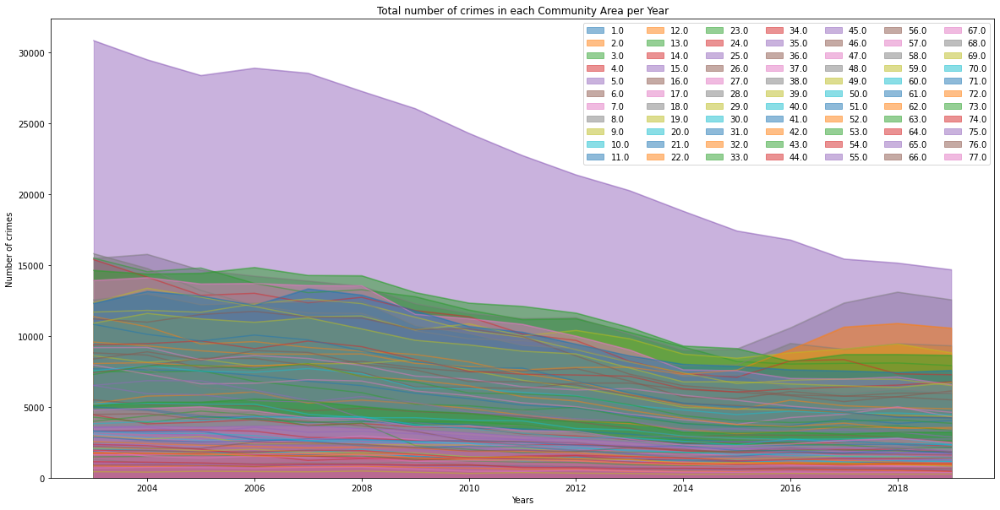

In [68]:
#let's print number of crimes during years
dfCrimesAreatoYears.plot(kind='area', 
             stacked=False,
             figsize=(20, 10) # pass a tuple (x, y) size
             )

plt.title('Total number of crimes in each Community Area per Year')
plt.ylabel('Number of crimes')
plt.xlabel('Years')
plt.legend(ncol=7)
plt.show()

Interesting, we have found that there is a Community Area that outstands the other ones for crime number and seems to be the main responsible for the whole negative trend we previously discovered in the crime number. This looks like an outlier and we will analyze it, but first let's determine which one is.

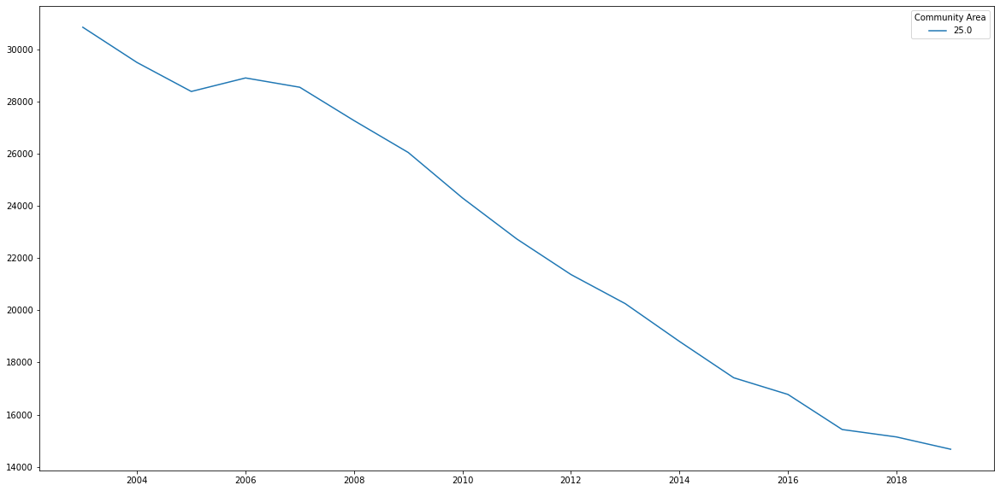

In [69]:
dfCrimesAreatoYears.loc[:,(list(dfCrimesAreatoYears.loc[[2018,2019],:].sum(axis=0).sort_values(ascending=False).index[:1]))].plot(figsize=(20, 10))

Perfect, the searched Community Area is the n. 25, i.e. Austin.  
Now, let's plot a new choropleth map that shows crime number per Community Area and let's put it above that of Hardship Index. This should give us an idea of how we could cluster the Neighborhoods.

In [80]:
dfCrimesArea['Community Area Name'] = dfSE_fin['COMMUNITY AREA NAME']

In [760]:
map_chicago2 = folium.Map(location=[latitude, longitude], zoom_start=11)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Community Area Hardship Index',
    data=dfSE_fin,
    columns=['COMMUNITY AREA NAME', 'HARDSHIP INDEX'],
    key_on='feature.properties.community',
    fill_color='YlOrRd', 
    fill_opacity=0.8, 
    line_opacity=0.5,
    legend_name='Chicago Community Area Hardship Index'
).add_to(map_chicago2)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Community Area 2003-2019 Total crimes',
    data=dfCrimesArea,
    columns=['Community Area Name', '2003-2019 Ar'],
    key_on='feature.properties.community',
    #bins=[0,15000,50000,100000,200000,300000,400000],
    fill_color='YlOrRd', 
    fill_opacity=0.6, 
    line_opacity=0.5,
    legend_name='Chicago Community Area 2003-2019 Total crimes',
).add_to(map_chicago2)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Community Area 2003-2019 Total crimes2',
    data=dfCrimesArea,
    columns=['Community Area Name', '2003-2019 No_Ar'],
    key_on='feature.properties.community',
    #bins=[0,15000,50000,100000,200000,300000,400000],
    fill_color='YlOrRd', 
    fill_opacity=0.3, 
    line_opacity=0.5,
    legend_name='Chicago Community Area 2003-2019 Total crimes',
).add_to(map_chicago2)


areaNames = FeatureGroup(name = 'Community Area Name Markers')
for area, lat, lng, hardship in zip(comAreaTitle,dumpLat,dumpLong,list(dfSE_fin['HARDSHIP INDEX'])):
    Marker(location = [lat, lng], popup = area, tooltip = None, draggable = False).add_to(areaNames)
areaNames.add_to(map_chicago2)


LayerControl().add_to(map_chicago2)
map_chicago2

The map confirms that, when considering also crimes, the Community Areas are more uniform respect the case of considering only their Hardship Index.  
The map also confirms that Austin is an outlier. So we will check if our clustering model will intercept this outlier or if we will have to drop it, in order to have more significant results.  
  
Let's build a dataframe we use for clustering Community Areas

In [72]:
dfCrimesArea.columns

Index(['Community Area', '2003 Ar', '2003 No_Ar', '2003 Total', '2004 Ar',
       '2004 No_Ar', '2004 Total', '2005 Ar', '2005 No_Ar', '2005 Total',
       '2006 Ar', '2006 No_Ar', '2006 Total', '2007 Ar', '2007 No_Ar',
       '2007 Total', '2008 Ar', '2008 No_Ar', '2008 Total', '2009 Ar',
       '2009 No_Ar', '2009 Total', '2010 Ar', '2010 No_Ar', '2010 Total',
       '2011 Ar', '2011 No_Ar', '2011 Total', '2012 Ar', '2012 No_Ar',
       '2012 Total', '2013 Ar', '2013 No_Ar', '2013 Total', '2014 Ar',
       '2014 No_Ar', '2014 Total', '2015 Ar', '2015 No_Ar', '2015 Total',
       '2016 Ar', '2016 No_Ar', '2016 Total', '2017 Ar', '2017 No_Ar',
       '2017 Total', '2018 Ar', '2018 No_Ar', '2018 Total', '2019 Ar',
       '2019 No_Ar', '2019 Total', '2003-2019 Ar', '2003-2019 No_Ar',
       '2003-2019 Total', 'Community Area Name'],
      dtype='object')

In [81]:
#let's rely only on the total number of crimes in the period 2002-2019, so let's keep only the relevant columns
dfCrimesAreaClus = dfCrimesArea[['Community Area Name','2003-2019 Ar','2003-2019 No_Ar']]

Let's merge the Hardship Index information in our dataframe

In [82]:
dfCrimesAreaClus['Hardship Index'] = dfSE_fin['HARDSHIP INDEX']

<ipython-input-82-e4fdf13c5926>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfCrimesAreaClus['Hardship Index'] = dfSE_fin['HARDSHIP INDEX']


In [83]:
dfCrimesAreaClus.head()

,Community Area Name,2003-2019 Ar,2003-2019 No_Ar,Hardship Index
0,ROGERS PARK,25666,66794,39.0
1,WEST RIDGE,13285,63136,46.0
2,UPTOWN,27218,60429,20.0
3,LINCOLN SQUARE,7928,34464,17.0
4,NORTH CENTER,6722,29189,6.0


We want to explore two clustering algorithm: DBSCAN and K-Mean. Each needs to have normalized numeric data, so let's move on in preparing our dataframe, by using Community Area Names as index values and preprocessing all numeric values

In [84]:
X = dfCrimesAreaClus[['2003-2019 Ar','2003-2019 No_Ar','Hardship Index']].values # X is a numpy array that keeps only the numeric values
min_max_scaler = preprocessing.MinMaxScaler() # we build a MinMaxScaler object
X_scaled = min_max_scaler.fit_transform(X) # and use it to normalize values
dfCrimesAreaClusNorm = pd.DataFrame(X_scaled) # the new dataframe with normalized values
dfCrimesAreaClusNorm.index = list(dfCrimesAreaClus['Community Area Name']) # setting the index with the names of Community Areas
dfCrimesAreaClusNorm.columns = ['2003-2019 Ar','2003-2019 No_Ar','Hardship Index'] # renaming the columns
dfCrimesAreaClusNorm

,2003-2019 Ar,2003-2019 No_Ar,Hardship Index
ROGERS PARK,0.164373,0.269477,0.391753
WEST RIDGE,0.082838,0.253474,0.463918
UPTOWN,0.174593,0.241631,0.195876
LINCOLN SQUARE,0.047560,0.128038,0.164948
NORTH CENTER,0.039618,0.104961,0.051546
LAKE VIEW,0.146928,0.408597,0.041237
LINCOLN PARK,0.080639,0.335611,0.010309
NEAR NORTH SIDE,0.362555,0.654799,0.000000
EDISON PARK,0.000000,0.000000,0.072165
NORWOOD PARK,0.020659,0.073939,0.206186


Let's plot the points representing the Community Area in order to visualize their distribution and let's add label for Austin Community Area

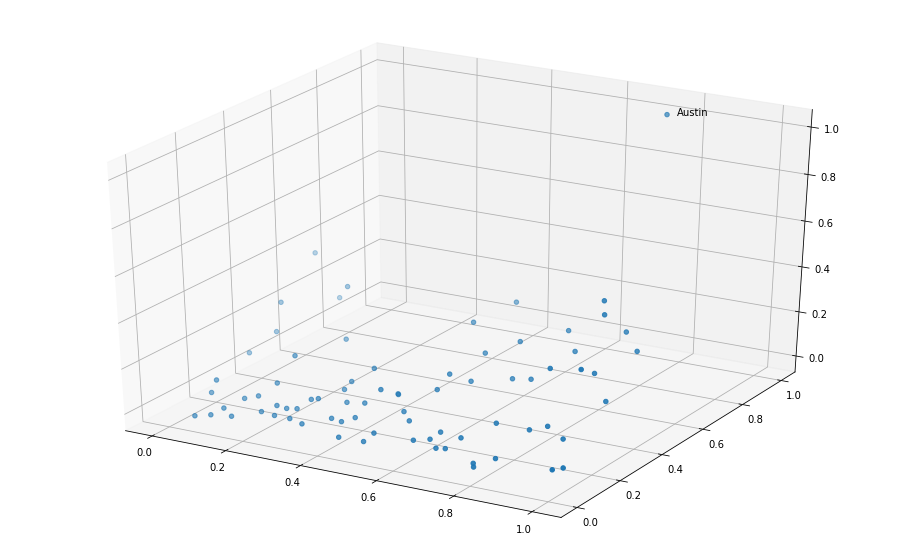

In [172]:
zdata = dfCrimesAreaClusNorm['2003-2019 Ar']
ydata = dfCrimesAreaClusNorm['2003-2019 No_Ar']
xdata = dfCrimesAreaClusNorm['Hardship Index']

fig = plt.figure(figsize=(16, 10))
ax = fig.add_subplot(111, projection='3d')
ax.text2D(0.75, 0.8, "Austin", transform=ax.transAxes)
ax.scatter3D(xdata, ydata, zdata, cmap='Greens')

We can clearly see how Austin is isolated apart from other Community Areas. Let's check if our clustering model is able to catch this.  
As DBSCAN algorithm is able to detect outliers and doesn't need to previously know the number of cluster, let's start with this one.

In [87]:
#DBSCAN model will check different values for radius and minimum number of samples to verify if it discovers and isolate community area 25, i.e. Austin.
for epsilon in np.arange(0.05, 0.4, 0.05):
    for minSamp in range(5,10):
        dbscanModel = DBSCAN(eps=epsilon, min_samples=minSamp).fit(dfCrimesAreaClusNorm)
        print("epsilon: ",epsilon,"  Samples Number: ",minSamp,"\n")
        if -1 in set(dbscanModel.labels_): 
            clusnumb= len(set(dbscanModel.labels_))-1
        else:
            clusnumb= len(set(dbscanModel.labels_))
        print("Number of detected clusters: ",clusnumb)
        if -1 in set(dbscanModel.labels_):
            for i in dbscanModel.labels_:
                j +=1
            print("Number of detected outliers: ", j)
        if dbscanModel.labels_[24] == -1:
            print("Austin is an outlier? Yes")
        else:
            print("Austin is an outlier? No")
        if dbscanModel.labels_[24] == -1 and j == 1:
            print("Austin is the unique outlier? Yes")
        elif dbscanModel.labels_[24] == -1 and j != 1:
            print("Austin is the unique outlier? No")
        print("\n\n")
        

epsilon:  0.05   Samples Number:  5 

Number of detected clusters:  1
Number of detected outliers:  137059
Austin is an outlier? Yes
Austin is the unique outlier? No



epsilon:  0.05   Samples Number:  6 

Number of detected clusters:  0
Number of detected outliers:  137136
Austin is an outlier? Yes
Austin is the unique outlier? No



epsilon:  0.05   Samples Number:  7 

Number of detected clusters:  0
Number of detected outliers:  137213
Austin is an outlier? Yes
Austin is the unique outlier? No



epsilon:  0.05   Samples Number:  8 

Number of detected clusters:  0
Number of detected outliers:  137290
Austin is an outlier? Yes
Austin is the unique outlier? No



epsilon:  0.05   Samples Number:  9 

Number of detected clusters:  0
Number of detected outliers:  137367
Austin is an outlier? Yes
Austin is the unique outlier? No



epsilon:  0.1   Samples Number:  5 

Number of detected clusters:  1
Number of detected outliers:  137444
Austin is an outlier? Yes
Austin is the unique ou

DBSCAN seems not to be able to detect more than 2 clusters and to "isolate" the Community Area Austin.  
So let's try with K-Means. We know that K-Means need to be passed to the number of clusters. To find the best number we use the "elbow" method, through both distortion and inertia metrics, where:  
* **Distortion**: It is calculated as the average of the squared distances from the cluster centers of the respective clusters. Typically, the Euclidean distance metric is used;
* **Inertia**: It is the sum of squared distances of samples to their closest cluster center.


In [88]:
distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,20) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(dfCrimesAreaClusNorm) 
    kmeanModel.fit(dfCrimesAreaClusNorm)     
      
    distortions.append(sum(np.min(cdist(dfCrimesAreaClusNorm, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / dfCrimesAreaClusNorm.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(dfCrimesAreaClusNorm, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / dfCrimesAreaClusNorm.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 

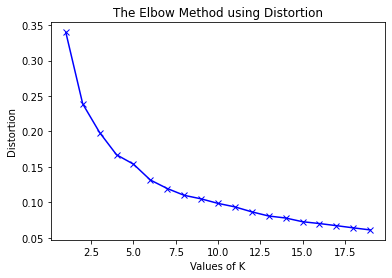

In [89]:
plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show() 

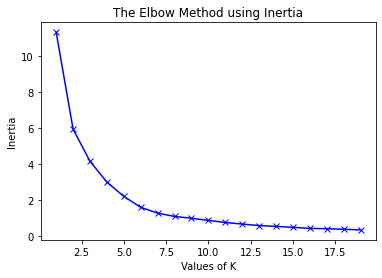

In [90]:
plt.plot(K, inertias, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Inertia') 
plt.title('The Elbow Method using Inertia') 
plt.show()

Both method suggest a K number around 6. Let's try it

In [85]:
kmeanModel = KMeans(n_clusters=6).fit(dfCrimesAreaClusNorm)
kmeanModel.labels_

array([4, 4, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 4, 4, 4, 1, 4, 3, 0, 4, 2,
       3, 2, 5, 3, 3, 2, 3, 3, 0, 2, 1, 0, 4, 0, 0, 4, 1, 0, 1, 4, 3, 3,
       4, 3, 0, 4, 3, 4, 0, 0, 4, 0, 4, 1, 0, 0, 0, 4, 3, 0, 0, 1, 4, 3,
       3, 3, 3, 4, 3, 1, 4, 1, 1, 1, 1])

Very good! K = 6 divides the Community Areas in 6 clusters where Austin is detected as a cluster "per se". Indeed we can easily see that its relative cluster value, i.e. n.5, is unique in the above list.  
We will use therefore this model for our scope.  
  
Let's begin to build our final dataset that will be used for the classification Tree model.

In [86]:
#let's keep Community Area Number and Name columns
dfChicagoVenuesLab = dfCrimesArea[['Community Area', 'Community Area Name']]

In [87]:
#let's add the area label obtained by the clustering model
dfChicagoVenuesLab['Area Label'] = list(kmeanModel.labels_)
dfChicagoVenuesLab

<ipython-input-87-68354c1fee08>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfChicagoVenuesLab['Area Label'] = list(kmeanModel.labels_)


,Community Area,Community Area Name,Area Label
0,1.0,ROGERS PARK,4
1,2.0,WEST RIDGE,4
2,3.0,UPTOWN,1
3,4.0,LINCOLN SQUARE,1
4,5.0,NORTH CENTER,1
5,6.0,LAKE VIEW,2
6,7.0,LINCOLN PARK,2
7,8.0,NEAR NORTH SIDE,2
8,9.0,EDISON PARK,1
9,10.0,NORWOOD PARK,1


Confronting the obtained area label values with the Community Area choropleth map we printed before, we map values a s follows:  
  
* 3 --> Very Good
* 1 --> Good
* 4 --> Nice
* 0 --> Average
* 2 --> Bad
* 5 --> Very Bad  
  
In next cell we subsitute numerical values with the above defined categorical ones

In [88]:
for i in range(dfChicagoVenuesLab.shape[0]):
    if dfChicagoVenuesLab.loc[i,'Area Label'] == 0:
        dfChicagoVenuesLab.loc[i,'Area Label'] = "Average"
    elif dfChicagoVenuesLab.loc[i,'Area Label'] == 1:
        dfChicagoVenuesLab.loc[i,'Area Label'] = "Good"
    elif dfChicagoVenuesLab.loc[i,'Area Label'] == 2:
        dfChicagoVenuesLab.loc[i,'Area Label'] = "Bad"
    elif dfChicagoVenuesLab.loc[i,'Area Label'] == 3:
        dfChicagoVenuesLab.loc[i,'Area Label'] = "Very Good"
    elif dfChicagoVenuesLab.loc[i,'Area Label'] == 4:
        dfChicagoVenuesLab.loc[i,'Area Label'] = "Nice"
    else:
        dfChicagoVenuesLab.loc[i,'Area Label'] = "Very Bad"
dfChicagoVenuesLab       

c:\users\user\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


,Community Area,Community Area Name,Area Label
0,1.0,ROGERS PARK,Nice
1,2.0,WEST RIDGE,Nice
2,3.0,UPTOWN,Good
3,4.0,LINCOLN SQUARE,Good
4,5.0,NORTH CENTER,Good
5,6.0,LAKE VIEW,Bad
6,7.0,LINCOLN PARK,Bad
7,8.0,NEAR NORTH SIDE,Bad
8,9.0,EDISON PARK,Good
9,10.0,NORWOOD PARK,Good


In [89]:
dfChicagoVenuesLab.to_csv('dfChicagoVenuesLab.csv')

In [7]:
dfChicagoVenuesLab = pd.read_csv('dfChicagoVenuesLab.csv')

We want now to add venue categories to our Community Areas. How can we get those? Foursquare API let you to obtain reccomended venues inside a circle with a given center on the map.  
So the first option could be that to center our circle in the center of the City bounding box , use a large radius and get venues.  

In [121]:
#for visualization purpose, we create a dataframe that we use to "color" the city of Chicago and visualize its boundaries
#dfSE_map = dfSE_fin.copy()
mapColumns = list(dfSE_fin.columns)
mapColumns[2] = 'COLOR INDEX'
dfSE_map.columns = mapColumns
dfSE_map['COLOR INDEX'] = dfSE_map['COLOR INDEX'] - dfSE_map['COLOR INDEX']
dfSE_map.head()

,Community Area Number,COMMUNITY AREA NAME,COLOR INDEX,LATITUDE,LONGITUDE
0,1.0,ROGERS PARK,0.0,42.011938,-87.665677
1,2.0,WEST RIDGE,0.0,41.999314,-87.697159
2,3.0,UPTOWN,0.0,41.965619,-87.644680
3,4.0,LINCOLN SQUARE,0.0,41.974304,-87.694233
4,5.0,NORTH CENTER,0.0,41.946454,-87.687485


In [122]:
map_chicago3 = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Base Color',
    data=dfSE_map,
    columns=['COMMUNITY AREA NAME', 'COLOR INDEX'],
    key_on='feature.properties.community',
    fill_color='OrRd', 
    fill_opacity=0.3, 
    line_opacity=1,
    legend_name='Chicago City Boundaries'
).add_to(map_chicago3)

folium.Circle(location = [latitude-0.015, longitude-0.05], radius = 28000, color='blue', fill=True).add_to(map_chicago3)

map_chicago3

Anyway this option is not valid as, per every query, Foursquare returns only a limited number of results.
Now, if we look at the Chicago map, we notice that:  
* it has its vertical dimension larger than the horizontal one
* its shape is barely regular, i.e. even if it resembles a rectangle, its vertical edges are not really regular (straight)
We could therefore subdivide its area in more circles. Anyway, if we go with only 3,4 big circles, we have again the problem of few results and also that of some areas won't be covered well. To avoid the latter we could use overlapping circles, but then we should delete all the redundant venues from overlapping regions. 

In [152]:
map_chicago4 = folium.Map(location=[latitude, longitude], zoom_start=10)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Base Color',
    data=dfSE_map,
    columns=['COMMUNITY AREA NAME', 'COLOR INDEX'],
    key_on='feature.properties.community',
    fill_color='OrRd', 
    fill_opacity=0.3, 
    line_opacity=1,
    legend_name='Chicago City Boundaries'
).add_to(map_chicago4)

folium.Circle(location = [latitude+0.09, longitude-0.22], radius = 10000, color='blue', fill=True).add_to(map_chicago4)
folium.Circle(location = [latitude-0.015, longitude-0.05], radius = 8000, color='blue', fill=True).add_to(map_chicago4)
folium.Circle(location = [latitude+0.09, longitude-0.05], radius = 7000, color='blue', fill=True).add_to(map_chicago4)
folium.Circle(location = [latitude-0.16, longitude+0.02], radius = 10000, color='blue', fill=True).add_to(map_chicago4)
folium.Circle(location = [latitude-0.09, longitude-0.12], radius = 4000, color='blue', fill=True).add_to(map_chicago4)

map_chicago4

So we decided to go with the following solution:  
1. build a grid of "packed" relative small circles.   
2. delete the circles that are outside the city's boundaries, in order to not have to make a lot of unuseful queries to Foursquare (let's remember that with a Sandbox or User account queries are limited)  
3. perform queries for the remaining circles  

This will assure to find a good number of not redundant venues in all the Chicago City.  
We finally assign every venues to a specific Community Area through a loop cycle that uses the shapely library and checks in which geometry boundary every venue is located. Next images will show the process 

In [157]:
map_chicago5 = folium.Map(location=[latitude, longitude], zoom_start=11)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Base Color',
    data=dfSE_map,
    columns=['COMMUNITY AREA NAME', 'COLOR INDEX'],
    key_on='feature.properties.community',
    fill_color='OrRd', 
    fill_opacity=0.3, 
    line_opacity=1,
    legend_name='Chicago City Boundaries'
).add_to(map_chicago5)

areaNames3 = FeatureGroup(name = 'Community Area Circle Markers')
areaNames4 = FeatureGroup(name = 'Circle Markers number')

a = 0
circNumb = 0


for lat in np.arange(min(dumpLat)-0.013, max(dumpLat)+0.013, 0.0065):   
    if a == 0:
        for lng in np.arange(min(dumpLong)-0.06, max(dumpLong), 0.01):
            folium.Circle(location = [lat, lng], radius = 415, color='crimson', fill=False, popup=circNumb).add_to(areaNames3)
            # we assign a number to every cirle in order to quickluy recognice qhich ones must be deleted
            folium.Marker([lat+0.0015, lng - 0.004],icon=DivIcon(icon_size=(150,36),icon_anchor=(0,0),html='<div style="font-size: 10pt">'+str(circNumb)+'</div>',)).add_to(areaNames4)
            circNumb +=1
        a = 1
        continue
    if a == 1:
        for lng in np.arange(min(dumpLong)-0.055, max(dumpLong), 0.01):
            folium.Circle(location = [lat, lng], radius = 415, color='crimson', fill=False, popup=circNumb).add_to(areaNames3)
            # we assign a number to every cirle in order to quickluy recognice qhich ones must be deleted
            folium.Marker([lat+0.0015, lng - 0.004],icon=DivIcon(icon_size=(150,36),icon_anchor=(0,0),html='<div style="font-size: 10pt">'+str(circNumb)+'</div>',)).add_to(areaNames4)
            circNumb +=1                
        a = 0
        continue


areaNames3.add_to(map_chicago5)
areaNames4.add_to(map_chicago5)

LayerControl().add_to(map_chicago5)
map_chicago5

Zooming on the above map we have noted which circles have to be deleted, so we have manually created the below list.  
A best approach could have been to utilize shapely library, anyway the job was not too much committing and could be done "by hand".

In [158]:
#defining the list of circles to be removed from Foursquare API queries
outList = [[2366,2377],  [2324,2335],  [2283,2285],  [2288,2294],  [2247,2252],  [2206,2211],  [2165,2166],  [2124],  [2082],  [2040,2041],  [2044,2048],  
[1992],  [1998,2000],  [2003,2006],  [1951,1953],  [1956,1959], [1962,1963],  [1909,1917],  [1868,1876],  [1826,1838],  [1785,1797],  [1743,1756],
[1702,1714],  [1660,1676],  [1619,1634],  [1577,1593],  [1536,1551],  [1494,1510], [1453,1468],  [1411,1427],  [1370,1389],  [1328,1347],
[1287,1306],  [1245,1264],  [1204,1223],  [1162,1181],  [1121,1140],  [1079,1098],  [1038,1056],  [996,1014],  [955,968],  [913,926],  [872,885],
[830,843],  [789,808],  [747,766],  [706,725],  [664,683],  [623,642],  [581,600],  [540,565],  [498,523],  [457,482],  [415,436],  [438,439],
[374,395],  [332,353],  [291,312],  [249,268],  [208,232],  [166,192],  [125,154],  [83,112],  [42,73],  [0,32],  [705], [746], [786,788],
[827,829],  [868,871],  [909,912], [950,954],  [992,995],  [1033,1037],  [1115,1120],  [1156,1161],  [1197,1203],  [1238,1244],  [1279,1286],
[1320,1327],  [1362,1369],  [1404,1410],  [1445,1452],  [1486,1493],  [1528,1535],  [1570,1576],  [1612,1618],  [1651,1659],  [1692,1701],
[1734,1742], [1775,1784],  [1816,1825],  [1858,1867],  [1899,1908],  [1940,1950],  [1981,1991],  [2024,2033],  [2065,2074],  [2105,2116], 
[2147,2157], [2188,2199],  [2229,2240],  [2270,2282],  [2312,2323],  [2353,2365],  [2394,2406], [2379,2388], [2338,2339], [2341,2346], [2296,2297],
[2301,2305], [2260,2263], [1074,1078]]

delList = []
for minilist in outList:
    if len(minilist) == 1:
        delList.append(minilist[0])
    else:
        for i in range(minilist[0],minilist[1]+1):
            delList.append(i)
delList.sort()

Below it is what we got

In [160]:
map_chicago6 = folium.Map(location=[latitude, longitude], zoom_start=11)

folium.Choropleth(
    geo_data=json_data,
    name='Chicago Base Color',
    data=dfSE_map,
    columns=['COMMUNITY AREA NAME', 'COLOR INDEX'],
    key_on='feature.properties.community',
    fill_color='OrRd', 
    fill_opacity=0.3, 
    line_opacity=1,
    legend_name='Chicago City Boundaries'
).add_to(map_chicago6)


areaNames6 = FeatureGroup(name = 'Final Circle Markers')

a = 0
circNumb = 0
venuesCirc = []

for lat in np.arange(min(dumpLat)-0.013, max(dumpLat)+0.013, 0.0065):   
    if a == 0:
        for lng in np.arange(min(dumpLong)-0.06, max(dumpLong), 0.01):
            if circNumb in delList:
                circNumb +=1
            else:
                folium.Circle(location = [lat, lng], radius = 415, color='crimson', fill=False, popup=circNumb).add_to(areaNames6)
                venuesCirc.append([lat, lng])
                circNumb +=1
        a = 1
        continue
    if a == 1:
        for lng in np.arange(min(dumpLong)-0.055, max(dumpLong), 0.01):
            if circNumb in delList:
                circNumb +=1
            else:
                folium.Circle(location = [lat, lng], radius = 415, color='crimson', fill=False, popup=circNumb).add_to(areaNames6)
                venuesCirc.append([lat, lng])
                circNumb +=1                
        a = 0
        continue

areaNames6.add_to(map_chicago6)


LayerControl().add_to(map_chicago6)
map_chicago6

Perfect, we have all the circles in Chicago with a radius equals to 415 meters, i.e. all the points latitude and longitudes (we have saved them in the venuesCirc list) in which perform our queries to Foursquare. Now, first of all, let's see how many points we have

In [161]:
len(venuesCirc)

1040

We have 1040 queries to perform. Foursquare give us a limit of 500 queries per hour. Furthermore sometimes we can have some bad answers from Foursquare, due to congestion on their servers. So we split queries in 500 chunks, and we save a list of bad queries that will be performed again later.  
Queries with a correct answer are stored in temporary dataframes that finally will be merged (concatenated) together, in order to obtain the full list of venues.

In [ ]:
#first 500 queries loop
venues_list=[]
errorList = []
for i in range(0,500):
    lat = venuesCirc[i][0]
    lng = venuesCirc[i][1]
    url = 'https://api.foursquare.com/v2/venues/explore'            
    params = dict(
    oauth_token = myToken,
    ll = str(lat) + ',' + str(lng),
    v = version,
    radius = 415
    )
    try:
        resp = requests.get(url=url, params=params)
        data = json.loads(resp.text)
        results = data['response']['groups'][0]['items']
            
        venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        v['venue']['categories'][0]['name']) for v in results])

        nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        nearby_venues.columns = ['Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    except:
        errorList.append([venuesCirc[i][0],venuesCirc[i][1]])
        #print("error at request n. ",i+1)

In [439]:
#saving built dataframe
nearby_venues.to_csv("venues1.csv")

In [ ]:
#second 500 queries loop
venues_list=[]

for i in range(500,1000):
    lat = venuesCirc[i][0]
    lng = venuesCirc[i][1]
    url = 'https://api.foursquare.com/v2/venues/explore'            
    params = dict(
    oauth_token = myToken,
    ll = str(lat) + ',' + str(lng),
    v = version,
    radius = 415
    )
    try:
        resp = requests.get(url=url, params=params)
        data = json.loads(resp.text)
        results = data['response']['groups'][0]['items']
            
        venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        v['venue']['categories'][0]['name']) for v in results])

        nearby_venues2 = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        nearby_venues2.columns = ['Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    except:
        errorList.append([venuesCirc[i][0],venuesCirc[i][1]])
        #print("error at request n. ",i+1)

In [440]:
#saving built dataframe
nearby_venues2.to_csv("venues2.csv")

In [566]:
#last queries loop
venues_list=[]

for i in range(1001,len(venuesCirc)):
    lat = venuesCirc[i][0]
    lng = venuesCirc[i][1]
    url = 'https://api.foursquare.com/v2/venues/explore'            
    params = dict(
    oauth_token = myToken,
    ll = str(lat) + ',' + str(lng),
    v = version,
    radius = 415
    )
    try:
        resp = requests.get(url=url, params=params)
        data = json.loads(resp.text)
        results = data['response']['groups'][0]['items']
            
        venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        v['venue']['categories'][0]['name']) for v in results])

        nearby_venues3 = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        nearby_venues3.columns = ['Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    except:
        errorList.append([venuesCirc[i][0],venuesCirc[i][1]])
        #print("error at request n. ",i+1)

In [569]:
#saving built dataframe
nearby_venues3.to_csv("venues3.csv")

In [577]:
#first error list queries loop
venues_list=[]

errorList2 = []

for i in range(0,len(errorList2)):
    lat = errorList[i][0]
    lng = errorList[i][1]
    url = 'https://api.foursquare.com/v2/venues/explore'            
    params = dict(
    oauth_token = myToken,
    ll = str(lat) + ',' + str(lng),
    v = version,
    radius = 415
    )
    try:
        resp = requests.get(url=url, params=params)
        data = json.loads(resp.text)
        results = data['response']['groups'][0]['items']
        if len(results) == 0:
            print("no venues at point ",i)
            
        venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        v['venue']['categories'][0]['name']) for v in results])

        nearby_venues4 = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        nearby_venues4.columns = ['Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    except:
        errorList2.append([errorList[i][0],errorList[i][1]])
        print("error at request n. ",i+1)

In [577]:
#second error list queries loop
venues_list=[]

errorList3 = []

for i in range(0,len(errorList2)):
    lat = errorList2[i][0]
    lng = errorList2[i][1]
    url = 'https://api.foursquare.com/v2/venues/explore'            
    params = dict(
    oauth_token = myToken,
    ll = str(lat) + ',' + str(lng),
    v = version,
    radius = 415
    )
    try:
        resp = requests.get(url=url, params=params)
        data = json.loads(resp.text)
        results = data['response']['groups'][0]['items']
        if len(results) == 0:
            print("no venues at point ",i)
            
        venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        v['venue']['categories'][0]['name']) for v in results])

        nearby_venues5 = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        nearby_venues5.columns = ['Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    except:
        errorList3.append([errorList[i][0],errorList[i][1]])
        print("error at request n. ",i+1)

Ok, we have got all the venues. Let's merge temporary dataframes and save the final dataframe

In [581]:
#building and saving final dfChicagoVenues dataframe
dfChicagoVenues = pd.concat([nearby_venues, nearby_venues2, nearby_venues3, nearby_venues4,nearby_venues5])
dfChicagoVenues.to_csv("dfChicagoVenues.csv")

In [164]:
#reading dfChicagoVenues dataframe
dfChicagoVenues = pd.read_csv('dfChicagoVenues.csv')
dfChicagoVenues.drop('Unnamed: 0', axis=1, inplace=True)
dfChicagoVenues.head()

,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Skipper's Marina,41.650474,-87.607860,Harbor / Marina
1,Four Winds Yacht Club,41.646928,-87.601207,Nightlife Spot
2,Pier 11 Marina,41.646238,-87.601436,Harbor / Marina
3,Beaubien Woods Boat Launch,41.650373,-87.590518,Harbor / Marina
4,victor's roach coach,41.651083,-87.580839,Food Truck


Now we add and initialize a column to our dataframe in which we will put the Community Area to which every venue belongs and we reset dataframe index

In [165]:
dfChicagoVenues['Community Area Number'] = np.zeros_like(dfChicagoVenues.shape[0])
dfChicagoVenues = dfChicagoVenues.reset_index(drop=True)
dfChicagoVenues.head()

,Venue,Venue Latitude,Venue Longitude,Venue Category,Community Area Number
0,Skipper's Marina,41.650474,-87.607860,Harbor / Marina,0
1,Four Winds Yacht Club,41.646928,-87.601207,Nightlife Spot,0
2,Pier 11 Marina,41.646238,-87.601436,Harbor / Marina,0
3,Beaubien Woods Boat Launch,41.650373,-87.590518,Harbor / Marina,0
4,victor's roach coach,41.651083,-87.580839,Food Truck,0


In order to use shapely library for detecting the Community Area to which every venue belongs, we need a dictionary variable containing the geometry informations of every Community Area Boundary. Let's create it using our Chicago data dictionary that we created at the beginning of data section.

In [ ]:
polyDict = {}
for key, value in dataDict.items():
    if type(value) == list:
        for i in range (len(value)):
            for key2, value2 in value[i].items():
                if type(value2) == dict and 'area_numbe' in value2:
                    polyDict[int(value2['area_numbe'])] = []
                    tempKey = int(value2['area_numbe'])
                elif type(value2) == dict and 'coordinates' in value2:
                    polyDict[tempKey] = value2['coordinates'][0][0]

Finally, we check the Community Area of every venue and assign it to them. We verify also how many venues are outside of Chicago

In [181]:
c=0
for i in range(1,78):
    poly = Polygon(polyDict[i])
    for j in range(dfChicagoVenues.shape[0]):
        p1 = Point(dfChicagoVenues.loc[j,'Venue Longitude'], dfChicagoVenues.loc[j,'Venue Latitude'])
        if p1.within(poly):
            dfChicagoVenues.loc[j,'Community Area Number'] = float(i)
            c +=1
print("Total number of venues found: ",dfChicagoVenues.shape[0])
print("Number of venues outside Chicago Community Areas Boundaries: ",dfChicagoVenues.shape[0]-c)
dfChicagoVenues.head()

Total number of venues found:  17079
Number of venues outside Chicago Community Areas Boundaries:  666


,Venue,Venue Latitude,Venue Longitude,Venue Category,Community Area Number
0,Skipper's Marina,41.650474,-87.607860,Harbor / Marina,54.0
1,Four Winds Yacht Club,41.646928,-87.601207,Nightlife Spot,54.0
2,Pier 11 Marina,41.646238,-87.601436,Harbor / Marina,54.0
3,Beaubien Woods Boat Launch,41.650373,-87.590518,Harbor / Marina,54.0
4,victor's roach coach,41.651083,-87.580839,Food Truck,55.0


We have scraper more than 17K venues. 666 of these are out of any Community Area boundary, so let's drop these rows.

In [182]:
dfChicagoVenues = dfChicagoVenues[dfChicagoVenues['Community Area Number'] != 0]
dfChicagoVenues = dfChicagoVenues.reset_index(drop=True)
dfChicagoVenues.shape

(16413, 5)

In [183]:
#saving dataframe for future usage
dfChicagoVenues.to_csv('dfChicagoVenues.csv')

Let's check how many different unique types of category are in the dataframe

In [184]:
len(list(dfChicagoVenues['Venue Category'].unique()))

485

And let's give a look at what these categories are

In [185]:
list(dfChicagoVenues['Venue Category'].unique())

['Harbor / Marina',
 'Nightlife Spot',
 'Food Truck',
 'Canal Lock',
 'Bar',
 'Beach Bar',
 'Mexican Restaurant',
 'Pizza Place',
 'American Restaurant',
 'Hardware Store',
 'Dry Cleaner',
 'Business Service',
 'Park',
 'Train Station',
 'Fast Food Restaurant',
 'Lake',
 'Residential Building (Apartment / Condo)',
 'Hill',
 'Art Museum',
 'Forest',
 'Garden',
 'River',
 'Greek Restaurant',
 'Discount Store',
 'Food',
 'Pet Store',
 'Ice Cream Shop',
 'Grocery Store',
 'Market',
 'Deli / Bodega',
 'Chinese Restaurant',
 'Currency Exchange',
 'Post Office',
 'Sports Club',
 'Fried Chicken Joint',
 'Child Care Service',
 'Health & Beauty Service',
 'Home Service',
 'Mobile Phone Shop',
 'Clothing Store',
 'Convenience Store',
 'Nature Preserve',
 'Baseball Field',
 'Movie Theater',
 'State / Provincial Park',
 'Fishing Spot',
 'Caribbean Restaurant',
 'Pool',
 'Restaurant',
 'Video Game Store',
 'Stationery Store',
 'Seafood Restaurant',
 'Snack Place',
 'Pier',
 'Supermarket',
 'Hunting 

Ok, now we have noticed that number of unique category types is very large. Furthermore, in this list, there are some venues that are not very meaningful, at least for our purpose, such as: Baggage Locker, Border Crossing, Bridge, Building, Canal Lock, Intersection, Lounge, Moving Target, Neighborhood, Plane, Platform, Pool Hall, Residential Building (Apartment / Condo), Road, Roof Deck, Toll Booth, Tree, Tunnel, Wings Joint, etc.  
So we will delete all the rows corresponding to these categories.   
Furthermore we want to simplify our category list with much less category types. As a matter of fact, always in the perspective of our goal, all restaurants can be merged in a general category called Restaurant, without disctinction if we are speaking about an Italian, Chinese, Indian, etc.. restaurant. The same concept is applied to all the other categories. So we add a column to our dataframe where we insert the new "Venue General Category".

In [562]:
#creating a list with all category to be deleted
catsList = ['Airport Food Court','Airport Gate','Airport Lounge','Airport Service','Airport Terminal','Baggage Locker', 'Border Crossing', 'Bridge','Building', 'Canal Lock', 'Gas Station', 'General Travel', 'Intersection', 'Lounge', 'Moving Target', 'Neighborhood', 'Plane', 'Platform', 'Pool Hall', 'Residential Building (Apartment / Condo)', 'Road', 'Roof Deck', 'Toll Booth', 'Tree', 'Tunnel', 'Wings Joint']
#deleting rows where venues belong to one of the unmeaningful category
for category in catsList:
    dfChicagoVenues = dfChicagoVenues[dfChicagoVenues['Venue Category'] != category]
dfChicagoVenues = dfChicagoVenues.reset_index(drop=True)

dfChicagoVenues.shape

(15927, 6)

In [189]:
adding the new "General Venue Category" column and reordering the columns
dfChicagoVenues['Venue General Category'] = np.zeros_like(dfChicagoVenues.shape[0])
dfChicagoVenues = dfChicagoVenues.reset_index(drop=True)
dfChicagoVenues = dfChicagoVenues[['Venue','Venue Category','Venue General Category','Community Area Number','Venue Latitude','Venue Longitude']]
dfChicagoVenues.head()

,Venue,Venue Category,Venue General Category,Community Area Number,Venue Latitude,Venue Longitude
0,Skipper's Marina,Harbor / Marina,0,54.0,41.650474,-87.607860
1,Four Winds Yacht Club,Nightlife Spot,0,54.0,41.646928,-87.601207
2,Pier 11 Marina,Harbor / Marina,0,54.0,41.646238,-87.601436
3,Beaubien Woods Boat Launch,Harbor / Marina,0,54.0,41.650373,-87.590518
4,victor's roach coach,Food Truck,0,55.0,41.651083,-87.580839


In [780]:
#saving dataframe for future usage
dfChicagoVenues.to_csv('dfChicagoVenues.csv')

Ok, so now we have to run multiple times the cell below in order to assign a General Category to every Venue Category. The for loop tests if in the Venue Category there is a keyword, and if it founds the keyword, it adds the new General Category to the corresponding venue. It also prints out the venue category that still need to be classified, in order to help the work.

In [214]:
cat2ClassList = list(dfChicagoVenues['Venue Category'].unique())

In [605]:
keyWord = 'Garden'
genCat = 'Outdoor'

for j in range(dfChicagoVenues.shape[0]):
    if keyWord == dfChicagoVenues.loc[j,'Venue Category']:
        dfChicagoVenues.loc[j,'Venue General Category'] = genCat
        if (dfChicagoVenues.loc[j,'Venue Category']) in cat2ClassList:
            cat2ClassList.remove(dfChicagoVenues.loc[j,'Venue Category'])

cat2ClassList.sort()

print(len(cat2ClassList), list(dfChicagoVenues['Venue General Category'].unique()))
cat2ClassList

0 ['Outdoor & Recreational', 'Nightlife', 'Food', 'Bar', 'Restaurant', 'Shop & Store', 'Professions, Firms, Companies, Activities', 'General Transportations', 'Arts, Culture & Entertainment', 'Market', 'Financial Services', 'Athletics & Sports', 'Health & Care', 'Beauty Service', 'Public Transportations & Taxi', 'Cafè & Pub', 'Boutique', 'Parking', 'Hospitality', 'Schools and Education', 'Social centers', 'Public PoI', 'Conventions & Events', 'Military Base', 'Spiritual Center', 'Tourism', 'Non-Profit']


[]

We have finally simplify a little bit more our dataframe merging some General Categories

In [272]:
#merging and renaming some category
keyWord = 'Food'
genCat = 'Fast Food'

for j in range(dfChicagoVenues.shape[0]):
    if keyWord == dfChicagoVenues.loc[j,'Venue General Category']:
        dfChicagoVenues.loc[j,'Venue General Category'] = genCat

Let's print our definitive list of General Categories and let's give a look to the dataframe

In [320]:
print(list(dfChicagoVenues['Venue General Category'].unique()))

['Outdoor & Recreational', 'Nightlife', 'Fast Food', 'Bar, Cafe & Pub', 'Restaurant', 'Shop & Store', 'Professions, Firms, Companies, Activities', 'Arts, Culture, Entertainment, Events', 'Athletics & Sports', 'Health & Care', 'Hospitality', 'Schools and Education', 'Public PoI']


In [221]:
'''
dfChicagoVenues = pd.read_csv('dfChicagoVenues.csv')
dfChicagoVenues.head()
'''

,Venue,Venue Category,Venue General Category,Community Area Number,Venue Latitude,Venue Longitude
0,Skipper's Marina,Harbor / Marina,Outdoor & Recreational,54.0,41.650474,-87.607860
1,Four Winds Yacht Club,Nightlife Spot,Nightlife,54.0,41.646928,-87.601207
2,Pier 11 Marina,Harbor / Marina,Outdoor & Recreational,54.0,41.646238,-87.601436
3,Beaubien Woods Boat Launch,Harbor / Marina,Outdoor & Recreational,54.0,41.650373,-87.590518
4,victor's roach coach,Food Truck,Food,55.0,41.651083,-87.580839


In the following cell we print out the 'Venue Category' and 'Venue General Category' columns in order to give an idea of how the different Venue Categories have been mapped into Venue General Categories 

In [274]:
dfChicagoVenues[['Venue Category','Venue General Category']]

,Venue Category,Venue General Category
0,Harbor / Marina,Outdoor & Recreational
1,Nightlife Spot,Nightlife
2,Harbor / Marina,Outdoor & Recreational
3,Harbor / Marina,Outdoor & Recreational
4,Food Truck,Fast Food
5,Bar,"Bar, Cafe & Pub"
6,Harbor / Marina,Outdoor & Recreational
7,Beach Bar,"Bar, Cafe & Pub"
8,Bar,"Bar, Cafe & Pub"
9,Harbor / Marina,Outdoor & Recreational


Let's check how many General Categories we have introduced

In [321]:
print("Number of unique General Categories: ",len(list(dfChicagoVenues['Venue General Category'].unique())))

Number of unique General Categories:  13


Good, we have reduced the number of categories to consider from 485 to 13.

Let's check which are the most common Venue General Categories in the City

In [322]:
dfChicagoVenues[['Venue','Venue General Category']].groupby('Venue General Category').count().sort_values('Venue', ascending=False)

,Venue
Venue General Category,
Shop & Store,3673
Fast Food,2759
"Professions, Firms, Companies, Activities",2474
Restaurant,2152
"Bar, Cafe & Pub",1215
Outdoor & Recreational,1147
Athletics & Sports,703
"Arts, Culture, Entertainment, Events",403
Health & Care,378


And let's visualize them on the map

In [323]:
genCatList = list(dfChicagoVenues['Venue General Category'].unique())

map_chicago7 = folium.Map(location=[latitude, longitude], zoom_start=11)

dictColors = {'Outdoor & Recreational':'#fc0303',
 'Nightlife':'#fc7703',
 'Fast Food':'#fcd703',
 'Bar, Cafe & Pub':'#befc03',
 'Restaurant':'#3dfc03',
 'Shop & Store':'#139e06',
 'Professions, Firms, Companies, Activities':'#069e69',
 'Arts, Culture, Entertainment, Events':'#0eccc6',
 'Athletics & Sports':'#0eb3cc',
 'Health & Care':'#0e86cc',
 'Hospitality':'#0d0d6e',
 'Schools and Education':'#6943a3',
 'Public PoI':'#a745bf'}

for j in range(dfChicagoVenues.shape[0]):
    myColor = dictColors[dfChicagoVenues.loc[j,'Venue General Category']]
    lat = dfChicagoVenues.loc[j,'Venue Latitude']
    lng = dfChicagoVenues.loc[j,'Venue Longitude']
    folium.Circle(location = [lat, lng], radius = 30, color= myColor, fill=True).add_to(map_chicago7)

map_chicago7

Now, let's move on and create our last dataframe that will be used for our final Decision Tree classification model.  
From the previous dataframe (dfChicagoVenues) let's keep only 'Community Area Number' and 'Venue General Category' columns

In [307]:
dfChicagoVenuesGen = dfChicagoVenues[['Community Area Number','Venue General Category']]
dfChicagoVenuesGen.head()

,Community Area Number,Venue General Category
0,54.0,Outdoor & Recreational
1,54.0,Nightlife
2,54.0,Outdoor & Recreational
3,54.0,Outdoor & Recreational
4,55.0,Fast Food


Now, let's one hot encoding the new dataframe, in order to transform categorical variable into numerical ones.

In [308]:
dfChicagoVenuesGen = pd.get_dummies(data=dfChicagoVenuesGen, prefix="", prefix_sep='', columns=['Venue General Category'])
dfChicagoVenuesGen.head()

,Community Area Number,"Arts, Culture, Entertainment, Events",Athletics & Sports,"Bar, Cafe & Pub",Fast Food,Health & Care,Hospitality,Nightlife,Outdoor & Recreational,"Professions, Firms, Companies, Activities",Public PoI,Restaurant,Schools and Education,Shop & Store
0,54.0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,54.0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,54.0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,54.0,0,0,0,0,0,0,0,1,0,0,0,0,0
4,55.0,0,0,0,1,0,0,0,0,0,0,0,0,0


Let's order our dataframe by Community Area Number

In [309]:
dfChicagoVenuesGen = dfChicagoVenuesGen.sort_values(by=['Community Area Number'])
dfChicagoVenuesGen.head()

,Community Area Number,"Arts, Culture, Entertainment, Events",Athletics & Sports,"Bar, Cafe & Pub",Fast Food,Health & Care,Hospitality,Nightlife,Outdoor & Recreational,"Professions, Firms, Companies, Activities",Public PoI,Restaurant,Schools and Education,Shop & Store
13493,1.0,0,0,0,0,0,0,0,0,1,0,0,0,0
14714,1.0,0,0,0,0,0,0,0,0,0,0,1,0,0
14715,1.0,0,0,0,1,0,0,0,0,0,0,0,0,0
14716,1.0,0,0,0,0,0,0,0,0,1,0,0,0,0
14717,1.0,0,0,0,0,0,0,0,0,0,0,0,0,1


Let's group the dataframe by Community Area Number and sum the number of Venue General Category in order to obtain the total number of Venue General Category per Community Area

In [310]:
dfChicagoVenuesGen = dfChicagoVenuesGen.groupby('Community Area Number').sum()
dfChicagoVenuesGen.head()

,"Arts, Culture, Entertainment, Events",Athletics & Sports,"Bar, Cafe & Pub",Fast Food,Health & Care,Hospitality,Nightlife,Outdoor & Recreational,"Professions, Firms, Companies, Activities",Public PoI,Restaurant,Schools and Education,Shop & Store
Community Area Number,,,,,,,,,,,,,
1.0,18,24,40,74,10,4,0,54,68,0,76,0,108
2.0,2,20,25,111,20,0,1,33,75,0,123,2,146
3.0,10,43,29,28,9,1,0,40,25,3,49,0,34
4.0,4,16,38,27,5,0,1,16,29,1,41,1,44
5.0,4,22,32,26,9,0,3,15,18,0,32,2,50


In order to correctly visualize our final Tree Decision model, we have to simplify the name of our Features

In [311]:
#defining a new names list
changeColList = ['Cult', 'Sport', 'Cafe', 'Food', 'Health', 
                 'Hospitality', 'Nightlife', 'Outdoor', 'Activities', 'Pub_PoI', 
                 'Restaurant', 'School', 'Shop']

In [312]:
#changing columns names
dfChicagoVenuesGen.columns = changeColList

In [313]:
#saving dataframe
dfChicagoVenuesGen.to_csv('dfChicagoVenuesGen.csv')

In [91]:
'''
#loading dataframe
dfChicagoVenuesGen = pd.read_csv('dfChicagoVenuesGen.csv')
'''

We need to convert the Community Area Population Density series catched from dfChicagoPopArea dataframe into float as we need it later in order to engineer our Features

In [173]:
#converting Community Area Population Density from object to float and resetting its index
dfChicagoPopArea['Community Area Population Density [people/km^2]'] = dfChicagoPopArea['Community Area Population Density [people/km^2]'].apply(lambda x: float(x.split()[0].replace(',', '')))
dfChicagoPopArea['Community Area Population Density [people/km^2]'].index = np.arange(1.0,78.0,1.0)
dfChicagoPopArea['Community Area Population Density [people/km^2]']

1.0     11554.11
2.0      8336.20
3.0      9648.06
4.0      6291.50
5.0      6740.59
6.0     12433.23
7.0      8273.10
8.0     12526.20
9.0      1635.30
10.0     3276.92
11.0     4442.33
12.0     2294.78
13.0     2886.88
14.0    10455.33
15.0     6285.84
16.0     6568.06
17.0     4534.52
18.0     5393.73
19.0     7890.90
20.0     7967.57
21.0     7286.80
22.0     7856.05
23.0     6051.83
24.0     7123.67
25.0     5144.07
26.0     5177.09
27.0     4000.26
28.0     4266.26
29.0     4323.74
30.0     6296.33
31.0     4333.83
32.0     8395.97
33.0     5123.44
34.0     5195.00
35.0     4862.78
36.0     4423.53
37.0     1326.34
38.0     4951.20
39.0     6381.45
40.0     2921.68
41.0     6433.52
42.0     4340.01
43.0     6643.86
44.0     4073.05
45.0     3084.18
46.0     3267.19
47.0     1426.68
48.0     2909.67
49.0     3399.06
50.0     1204.38
51.0      517.66
52.0     3075.47
53.0     3008.78
54.0      808.74
55.0      693.95
56.0     3322.12
57.0     2524.46
58.0     6361.18
59.0     4317.

And finally let's build our Feature Matrix dataframe by calculating the ratio of Venue General Categories per 1000 people in every Community Area and renaming its columns

In [314]:
dfChicagoVenuesGenRatio = dfChicagoVenuesGen.copy()
colNamesList = []
for col in list(dfChicagoVenuesGenRatio.columns):
    dfChicagoVenuesGenRatio[col] = dfChicagoVenuesGenRatio[col]/dfChicagoPopArea['Community Area Population Density [people/km^2]']
    dfChicagoVenuesGenRatio[col] = dfChicagoVenuesGenRatio[col]*1000
    dfChicagoVenuesGenRatio[col] = round(dfChicagoVenuesGenRatio[col],1)
    colNamesList.append(col + "_1K")

dfChicagoVenuesGenRatio.columns = colNamesList
dfChicagoVenuesGenRatio

,Cult_1K,Sport_1K,Cafe_1K,Food_1K,Health_1K,Hospitality_1K,Nightlife_1K,Outdoor_1K,Activities_1K,Pub_PoI_1K,Restaurant_1K,School_1K,Shop_1K
Community Area Number,,,,,,,,,,,,,
1.0,1.6,2.1,3.5,6.4,0.9,0.3,0.0,4.7,5.9,0.0,6.6,0.0,9.3
2.0,0.2,2.4,3.0,13.3,2.4,0.0,0.1,4.0,9.0,0.0,14.8,0.2,17.5
3.0,1.0,4.5,3.0,2.9,0.9,0.1,0.0,4.1,2.6,0.3,5.1,0.0,3.5
4.0,0.6,2.5,6.0,4.3,0.8,0.0,0.2,2.5,4.6,0.2,6.5,0.2,7.0
5.0,0.6,3.3,4.7,3.9,1.3,0.0,0.4,2.2,2.7,0.0,4.7,0.3,7.4
6.0,1.4,3.5,6.7,3.7,0.7,0.2,0.2,2.4,2.4,0.3,6.4,0.1,6.1
7.0,2.1,3.5,7.6,4.4,1.6,0.2,0.2,7.4,3.3,0.1,7.9,0.0,11.8
8.0,1.8,2.9,4.7,3.9,1.1,0.9,0.3,2.2,2.4,0.5,5.4,0.2,6.4
9.0,3.7,7.3,7.3,18.3,4.9,0.0,0.0,3.7,23.8,0.0,14.1,0.0,24.5


In [315]:
#saving dataframe
dfChicagoVenuesGenRatio.to_csv('dfChicagoVenuesGenRatio.csv')

In [6]:
'''
#loading dataframe
dfChicagoVenuesGenRatio = pd.read_csv('dfChicagoVenuesGenRatio.csv')
'''

Perfect. The above one represents our dataset upon which we are going to build our final model, i.e. our Feature Matrix. We only lack to recall our target variable series, i.e. the category series in which Community Areas have been classified by the K-Means model.

In [316]:
X = dfChicagoVenuesGenRatio.values
X[0:5]

array([[ 1.6,  2.1,  3.5,  6.4,  0.9,  0.3,  0. ,  4.7,  5.9,  0. ,  6.6,
         0. ,  9.3],
       [ 0.2,  2.4,  3. , 13.3,  2.4,  0. ,  0.1,  4. ,  9. ,  0. , 14.8,
         0.2, 17.5],
       [ 1. ,  4.5,  3. ,  2.9,  0.9,  0.1,  0. ,  4.1,  2.6,  0.3,  5.1,
         0. ,  3.5],
       [ 0.6,  2.5,  6. ,  4.3,  0.8,  0. ,  0.2,  2.5,  4.6,  0.2,  6.5,
         0.2,  7. ],
       [ 0.6,  3.3,  4.7,  3.9,  1.3,  0. ,  0.4,  2.2,  2.7,  0. ,  4.7,
         0.3,  7.4]])

In [178]:
targetSeries = dfChicagoVenuesLab['Area Label']
targetSeries.index = range(0,77,1)
targetSeries

0          Nice
1          Nice
2          Good
3          Good
4          Good
5           Bad
6           Bad
7           Bad
8          Good
9          Good
10         Good
11         Good
12         Good
13         Nice
14         Nice
15         Nice
16         Good
17         Nice
18    Very Good
19      Average
20         Nice
21          Bad
22    Very Good
23          Bad
24     Very Bad
25    Very Good
26    Very Good
27          Bad
28    Very Good
29    Very Good
30      Average
31          Bad
32         Good
33      Average
34         Nice
35      Average
36      Average
37         Nice
38         Good
39      Average
40         Good
41         Nice
42    Very Good
43    Very Good
44         Nice
45    Very Good
46      Average
47         Nice
48    Very Good
49         Nice
50      Average
51      Average
52         Nice
53      Average
54         Nice
55         Good
56      Average
57      Average
58      Average
59         Nice
60    Very Good
61      Average
62      

### 3.2 Model Building and Visualization

We have arrived at the final step of our analysis. We will try to build the best possible Tree Decision model that will be able to give us informations and answers to the Business Requirements stated at the beginning.  
Decision Tree has been choosen as, differently from other algorithms, it explicitly gives informations on which Features contribute to the final classification.  
And so, it has seemed the best way to answer to Business Requirements.  
  
In order to do that, we have created a nested for loops that iteratively uses different parameters to find those that can give the average best model accuracy.  
As usual, the process consists in:  

* subdividing our dataset in training and test parts
* build a (DecisionTreeClassifier) model object
* fit the model with the training set
* using the trained model to predict new values of the test set
* measuring the model accuracy    

The parameters on which we can act are:  

* test_size, i.e. the percentage of dataframe rows to be used as test set
* random_state, i.e. a parameter that affects the shuffling of data before splitting between train and test sets
* max_depth, i. e. the maximum number of branching from the root toward the leaves of the Decision Tree model 

We will use the oyput of these for loops to know wich parameters give us the best result.  
As results depend upon random process in the training test initial split, we can't be sure to reproduce always the same model accuracy.  
Anyway this should give us a good idea of best parameters to adopt.

In [346]:
for ts in np.arange(0.20,0.3,0.05):
    for rs in range(2,5):
        for md in range(2,5):
            X_trainset, X_testset, y_trainset, y_testset = train_test_split(X, targetSeries, test_size=ts, random_state=rs)
            venueTree_test = DecisionTreeClassifier(criterion="entropy", max_depth = md)
            venueTree_test.fit(X_trainset,y_trainset)
            predTree_test = venueTree_test.predict(X_testset)
            modelAccuracy = metrics.accuracy_score(y_testset, predTree_test)
            print("ACCURACY: ", modelAccuracy,"\n","Test Size: ",ts,"  Random State: ",rs,"  Max Depth: ",md)




ACCURACY:  0.5 
 Test Size:  0.2   Random State:  2   Max Depth:  2
ACCURACY:  0.375 
 Test Size:  0.2   Random State:  2   Max Depth:  3
ACCURACY:  0.25 
 Test Size:  0.2   Random State:  2   Max Depth:  4
ACCURACY:  0.4375 
 Test Size:  0.2   Random State:  3   Max Depth:  2
ACCURACY:  0.3125 
 Test Size:  0.2   Random State:  3   Max Depth:  3
ACCURACY:  0.1875 
 Test Size:  0.2   Random State:  3   Max Depth:  4
ACCURACY:  0.5625 
 Test Size:  0.2   Random State:  4   Max Depth:  2
ACCURACY:  0.4375 
 Test Size:  0.2   Random State:  4   Max Depth:  3
ACCURACY:  0.5625 
 Test Size:  0.2   Random State:  4   Max Depth:  4
ACCURACY:  0.35 
 Test Size:  0.25   Random State:  2   Max Depth:  2
ACCURACY:  0.4 
 Test Size:  0.25   Random State:  2   Max Depth:  3
ACCURACY:  0.3 
 Test Size:  0.25   Random State:  2   Max Depth:  4
ACCURACY:  0.5 
 Test Size:  0.25   Random State:  3   Max Depth:  2
ACCURACY:  0.45 
 Test Size:  0.25   Random State:  3   Max Depth:  3
ACCURACY:  0.25 
 Te

Upon the above results we opted for the following parameters:  
* test size = 0.2
* random state = 4
* max depth = 4

In [318]:
X_trainset, X_testset, y_trainset, y_testset = train_test_split(X, targetSeries, test_size=0.2, random_state=4)
venueTree = DecisionTreeClassifier(criterion="entropy", max_depth = 4)
venueTree.fit(X_trainset,y_trainset)
predTree = venueTree.predict(X_testset)
modelAccuracy = metrics.accuracy_score(y_testset, predTree)
print("DecisionTrees's Accuracy: ", modelAccuracy)

DecisionTrees's Accuracy:  0.5625


Our final model has an accuracy of 0.5625. Not a great result, but not so bad too.  
Finally, let's visualize our Tree Decision model in order to get the conclusions

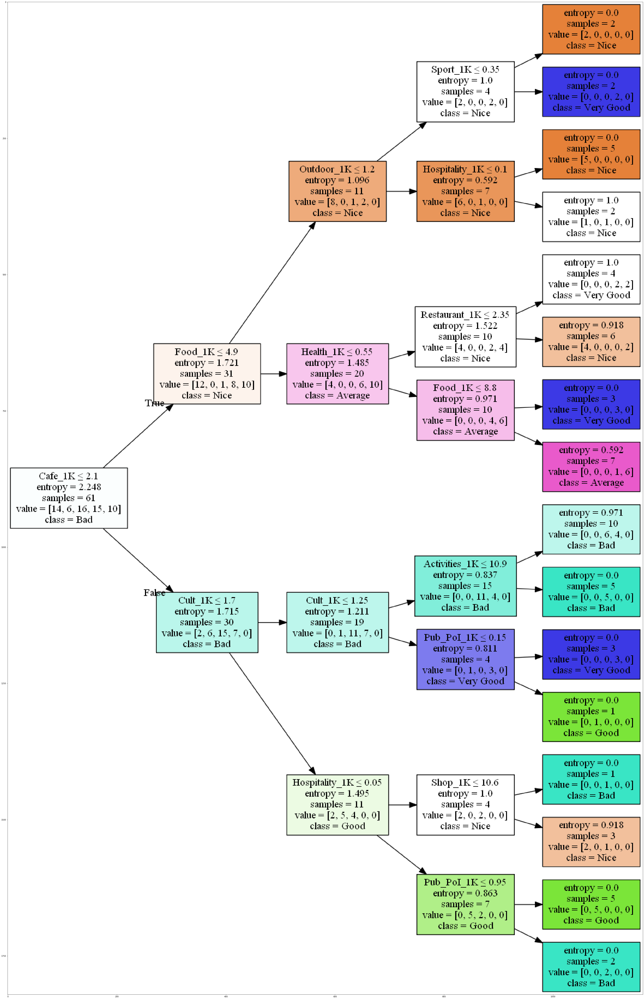

In [319]:
dot_data = StringIO()
filename = "venuetree.png"
featureNames = dfChicagoVenuesGenRatio.columns
targetNames = targetSeries.unique().tolist()
out=tree.export_graphviz(venueTree,feature_names=featureNames, out_file=dot_data, class_names= targetNames, filled=True,  special_characters=True,rotate=True)  
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(filename)
img = mpimg.imread(filename)
plt.figure(figsize=(60, 100))
plt.imshow(img,interpolation='nearest')

## 4. Results

Let's try to understand our results.  
The Decision Tree shows, in terms of number of Venue General Categories per 1000 people/Square Kilometer, which should be the best choices to do in order to improve the Neighborhood life quality.  
Obviously, as the accuracy of the model is just a little bit greater than 0.5, it means that the model has a certain degree of uncertainty. This fact can be seen in the graph, as sometimes the same Category is present twice.  Anyway, upon the obtained results we can try to give an **answer to our Business Requirements.**  

- **Evaluating if venues or activities help in the redevelopment process of a tough Neighborhood or not**  

     It looks that some venues can help in the process of requalification of City Neighborhood  
  

- **Evaluating which venue or activity categories should be stimulated by the mean of public investments and deploying a priority chart for venue categories that improve a Neighborhood**  
  
    It seems that **best investments** are those in **Arts, Cultural, Entertainment and Events** venues and/or activities.  
    The **second** important sector is **Hospitality** related activities and venues.
    **Third and fourth** come **Sport** venues **and Shops.**

- **Evaluating if maybe some venue category can have the opposite effect, i.e. they promote degradation of the Neighborhood**  
  
  It is not explicitly clear, but it looks like that **Bar and Pub can have a bad impact on quality of the Neighborhoods.**  
  If the same is not exactly valid also for **Food and Restaurant**, we can anyway notice that maybe an overdensity of these venues **can have a slightly bad impact as well.**


## 5. Discussion

Some remarks have to be done about this work.  
First, we have used socioeconomical data of Chicago City updated at 2014, so a little bit outdated, while crimes dataset can be considered more reliable as it is constantly updated.  
We have labelled Chicago Community Area through these datasets and we can expect a certain degree of error as the Socioeconomical one is quite old.  
As a matter of fact we have noticed how crimes have fallen during time, especially in the Community Area that was labelled as the worst one, i.e. Austin. Even if we have seen that Austin is currently the Community Area were most crimes are committed, it is that has had the biggest drop in percentage.  
So it is reasonable to think that some good intervention has been done and maybe the actual situation is not exactly as that depicted in our analysis.
Furthermore, venues scraped through Foursquare API are only those reccomended. It is not possible to get all the venues present in a certain area, especially with non professional accounts, and it is not possible to know if a particular venue was present or not at a certain time. This facts entail that maybe, some venue categories such as Police Departments or Public Offices, that could affect the Neighborhood quality, are not considered at all in the analysis; and, the lack of birthday of venues, make it impossible to evaluate how some venues can affect an Area during time.  
Again, there could be also errors due to the Author, as he is not from US and the process of generalizing the Venue Categories could not be done with an high degree of accuracy.  
Finally, we dealt only with 77 Community Area, as we restrict our analysis to one City. An interesting experiment would be that of consider in a wider study case more similar cities (for example metropolitan cities with a certain number of population and of similar cultural backround) and to redevelop the same model idea with a bigger set of observations.

## 6. Conclusion

Beside all the concerns stated in the previous section, we have develop a model that can somehow help a Public Administration to take decision about investments in order to improve the life quality in metropolitan cities, and especially in tough Neighborhoods.